<img src="https://i.imgur.com/4HjYIm8.jpeg" alt="alt text"/>


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
import os
import matplotlib.pyplot as plt # plots
import matplotlib.image as mpimg # abrir imagenes
import re
import shutil
import pandas as pd
import matplotlib.patches as patches # para agregar un bounding box
import numpy as np
from PIL import Image

import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Input, Conv2D, MaxPooling2D, Dropout, Flatten, Dense
import random
# tamaño de las imagenes que entran al modelo
MODEL_IMAGE_SIZE = 224

# Preprocesamiento de imagenes
Utilice una red YOLO v8 entrenada con ultralystic para detectar las caras de los gatos en las imagenes.
El modelo para detectar las caras de los gatos fue un YoloV8 de ultralystic entrenado con un [dataset de kaggle](https://www.kaggle.com/datasets/aleksandrdremov/cat-faces-detection), el entrenamiento también lo hice en kaggle y se puede ver en el notebook de *proyecto_gaticos_yolo*.

Aqui voy a dejar un ejemplo del procesamiento de las imágenes con el modelo de detección de caras

In [ ]:
images_path = '/content/drive/MyDrive/proyecto_ia_gaticos/imagenes_gatos_raw'
images_cats = os.listdir(images_path)

In [ ]:
images_cats

['Jellybean_71159687_1.jpeg',
 'Laney_54476273_1.jpeg',
 'Maisy_54476246_2.jpeg',
 'Black Widow_54475185_0.jpeg',
 'Jacob_54475191_2.jpeg',
 'Cher_54475260_0.jpeg',
 'Maverick_70567636_3.jpeg',
 'Lilah_59878015_4.jpeg',
 'patricia_1219321732.jpeg',
 'pamela_123129.jpeg']

In [ ]:
def get_cat_path(cat):
  return images_path + "/" + cat

def get_cat(cat):
  return mpimg.imread(get_cat_path(cat))

def show_cat(cat):
  img = get_cat(cat)
  plt.imshow(img)
  plt.show()

### Recortar cara del gatico


In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 799.4/799.4 kB 8.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-m

In [ ]:
from ultralytics import YOLO
# Cargo los pesos del modelo que entrené en kaggle
yolo_face = YOLO("/content/drive/MyDrive/proyecto_ia_gaticos/best_yolo_faces.pt")

In [ ]:
# para un bounding box normalizado
def bbox_normalized(img, bounding_box):
    height, width = img.shape[:2]
    x_center = int(bounding_box[0] * width)
    y_center = int(bounding_box[1] * height)
    w = int(bounding_box[2] * width)
    h = int(bounding_box[3] * height)

    x = int(x_center - w/2)
    y = int(y_center - h/2)
    return x,y,w,h

# imprimir una caja para un gato
def see_cat_box(cat, bounding_box, bbox_transformer = bbox_normalized):
    img = mpimg.imread(cat)

    x,y,w,h = bbox_transformer(img, bounding_box)

    plt.imshow(img)
    rect = patches.Rectangle((x,y), w, h, linewidth = 2, edgecolor = 'r', facecolor='none')
    # Add the rectangle to the plot
    plt.gca().add_patch(rect)
    plt.show()

def see_predictions(cats, bounding_boxes, bbox_transformer= bbox_normalized):

  num_rows = 2
  num_cols = 5

  # Create a figure and axes for the subplots
  fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))

  # Iterate through the randomly chosen indices and plot each cat
  for i in range(len(cats)):
      # Read the image
      img = mpimg.imread(get_cat_path(cats[i]))
      bounding_box = bounding_boxes[i]

      # Calculate subplot index
      row_idx = (i - 1) // num_cols
      col_idx = (i - 1) % num_cols

      # Plot the image
      axes[row_idx, col_idx].imshow(img)
      axes[row_idx, col_idx].axis('off')

      # Add bounding box
      x,y,w,h =  bbox_transformer(img, bounding_box)
      rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor='r', facecolor='none')
      axes[row_idx, col_idx].add_patch(rect)

  # Adjust layout
  plt.tight_layout()
  plt.show()

In [ ]:
# El modelo funciona con el archivo del gato
cat = images_cats[0]
source = get_cat_path(cat)

# Run inference on the source
results = yolo_face.predict(source, save=False)


image 1/1 /content/drive/MyDrive/proyecto_ia_gaticos/imagenes_gatos_raw/Jellybean_71159687_1.jpeg: 640x608 1 cat, 607.5ms
Speed: 21.9ms preprocess, 607.5ms inference, 37.1ms postprocess per image at shape (1, 3, 640, 608)


In [ ]:
bounding_box = np.array(results[0].boxes.xywhn[0])

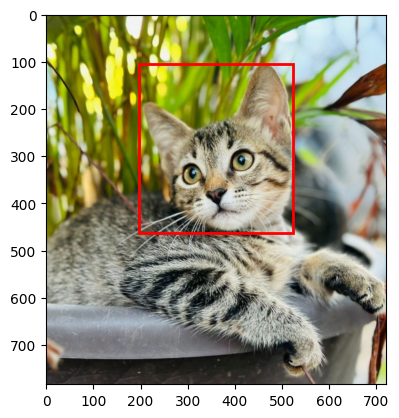

In [ ]:
see_cat_box(source, bounding_box)


0: 640x640 1 cat, 485.5ms
1: 640x640 1 cat, 485.5ms
2: 640x640 1 cat, 485.5ms
3: 640x640 1 cat, 485.5ms
4: 640x640 1 cat, 485.5ms
5: 640x640 1 cat, 485.5ms
6: 640x640 1 cat, 485.5ms
7: 640x640 1 cat, 485.5ms
8: 640x640 1 cat, 485.5ms
9: 640x640 1 cat, 485.5ms
Speed: 24.2ms preprocess, 485.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


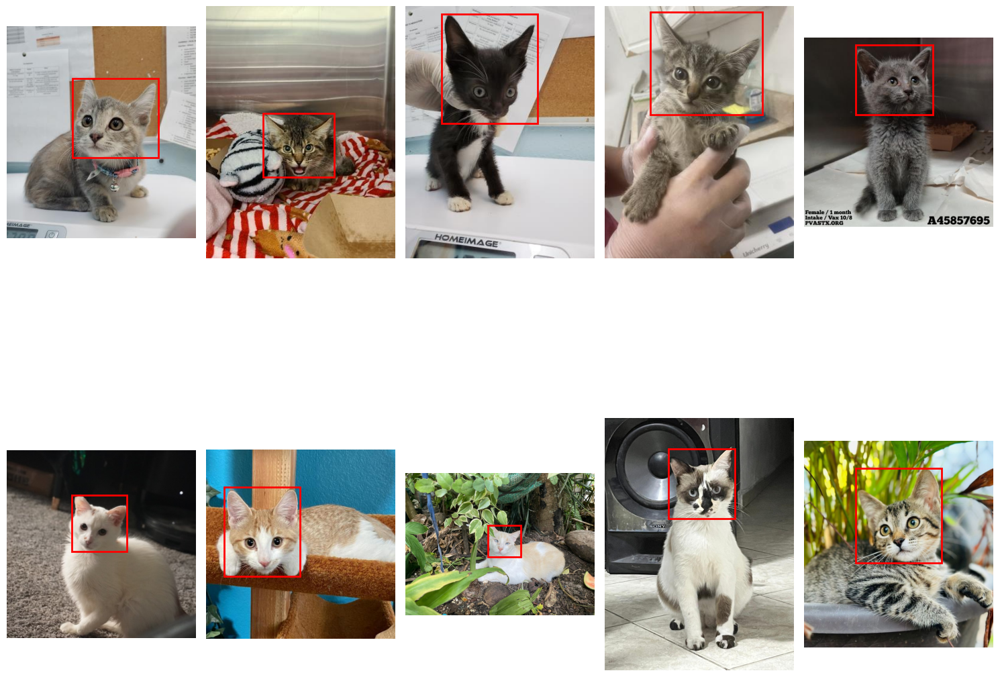

In [ ]:
cats = images_cats[:10]
sources = [get_cat_path(cat) for cat in cats]
results = yolo_face.predict(sources)

bounding_boxes = []
for r in results:
  xywhn = np.array(r.boxes.xywhn)
  if xywhn.shape[0] > 0:
    box = xywhn[0]
  else:
    box = np.array([0,0,0,0])
  bounding_boxes.append(box)

see_predictions(cats, bounding_boxes)

### Cortar una imagen a partir de un bounding box

In [ ]:
def crop_bbox(image, bbox):
  image = image.astype(int)
  x,y,w,h = bbox[:].astype(int)
  cropped_image = image[y:y+h, x:x+w]
  return cropped_image

In [ ]:
#@title Funcion para mostrar imagenes de gatos ya recortadas
import random
def show_cats_recortado(results):
  # Determine the grid size
  rows = 2
  cols = 5

  # Create a figure with subplots
  fig, axes = plt.subplots(rows, cols, figsize=(15, 6))

  # Plot each image in the corresponding subplot
  for i in range(len(results)):
    r = results[i]
    xywhn = np.array(r.boxes.xywhn)
    original_img = r.orig_img[..., ::-1] # reversing colors order because its BGR
    box = xywhn[0]
    box = np.array(bbox_normalized(original_img, box))
    cropped_face = crop_bbox(original_img, box)
    ax = axes[i // cols, i % cols]
    ax.imshow(cropped_face)
    ax.axis('off')  # Hide axes ticks

  # Adjust layout to prevent overlap
  plt.tight_layout()
  plt.show()

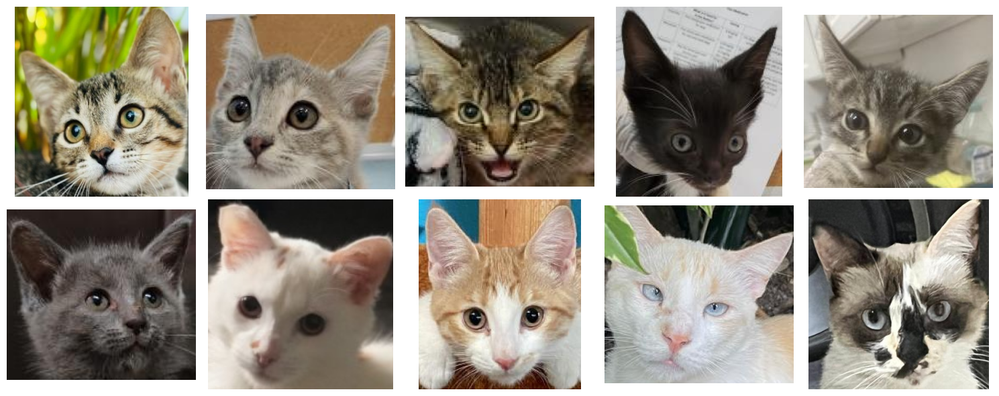

In [ ]:
show_cats_recortado(results[:10])

# Obtener imagenes ya preprocesadas!
Luego de recortar las imagenes de los gatos, les puse un tamaño de 224 x 224 x 3 y las guarde como .npy
A continuación obtengo las imágenes

In [4]:
# las imagenes se guardan en formato de bytes para poder guardarlas en el dataframe
# aqui se convierten en array
def get_cat(cat):
  image = np.frombuffer(cat.image, dtype=np.uint8)
  return image.reshape((224,224,3))

def show_cat(cat):
  img = get_cat(cat)
  plt.imshow(img)
  plt.show()

In [74]:
# Load the image arrays and IDs
train = np.load("/content/drive/MyDrive/proyecto_ia_gaticos/train.npy", allow_pickle=True)
val = np.load("/content/drive/MyDrive/proyecto_ia_gaticos/val.npy",  allow_pickle=True)
train_df = pd.DataFrame(train)
val_df = pd.DataFrame(val)

train_df.rename(columns={0: 'id', 1: 'image'}, inplace=True)
val_df.rename(columns={0: 'id', 1: 'image'}, inplace=True)

df_face = pd.concat([train_df, val_df], axis=0, ignore_index=True)
#ids = np.load('/content/drive/MyDrive/proyecto_ia_gaticos/ids_gatos.npy')
#image_arrays = np.load('/content/drive/MyDrive/proyecto_ia_gaticos/images_gatos.npy')

# Convert image arrays to byte arrays for storage in DataFrame
#image_arrays_bytes = [img_array.tobytes() for img_array in image_arrays]

# Create the DataFrame
#df_face = pd.DataFrame({
#    'id': ids,
#    'image': image_arrays_bytes
#})

Limpiar el dataframe y obetener datos de training, testeo y validacion

In [75]:
id_counts = df_face.groupby('id').size()
min_count = id_counts.min()
max_count = id_counts.max()

print(f"De cada gato hay minimo {min_count} imagenes y máximo {max_count} imágenes")
print("Cantidad de gatos", df_face["id"].unique().shape)
print("Cantidad de imagenes", df_face.shape)


De cada gato hay minimo 2 imagenes y máximo 6 imágenes
Cantidad de gatos (1416,)
Cantidad de imagenes (4730, 2)


In [ ]:
# esto lo hacia antes pero ahora el dataset viene dividido
from sklearn.model_selection import train_test_split
# Function to split the dataset
def split_dataset(df, test_size, random_state=123):
    unique_ids = df['id'].unique()

    train_ids, test_ids = train_test_split(unique_ids, test_size=test_size, random_state=random_state, shuffle=True)

    train_df = df[df['id'].isin(train_ids)]
    test_df = df[df['id'].isin(test_ids)]

    return train_df, test_df

train_df, val_df = split_dataset(df_face, 0.4)

train_unique_ids = train_df["id"].unique()
val_unique_ids = val_df["id"].unique()

print(f"Cantidad de gatos para entrenamiento {train_unique_ids.shape[0]}):")
print("Imagenes de entrenamiento: ", train_df.shape)

print(f"\nCantidad de gatos para validacion y testeo {val_unique_ids.shape[0]}):")
print("Imagenes de testeo y validacion", val_df.shape)

Cantidad de gatos para entrenamiento 849):
Imagenes de entrenamiento:  (2816, 2)

Cantidad de gatos para validacion y testeo 567):
Imagenes de testeo y validacion (1914, 2)


In [ ]:
#@title Funcion para mostrar gatos del dataframe
def show_df_cats(df, num_images=10):
  # Number of images to display
  cats = df.sample(num_images)

  # Determine the grid size
  rows = 2
  cols = int(num_images/2)

  # Create a figure with subplots
  fig, axes = plt.subplots(rows, cols, figsize=(15, 6))

  # Plot each image in the corresponding subplot
  for i in range(num_images):
      img = get_cat(cats.iloc[i])
      ax = axes[i // cols, i % cols]
      ax.imshow(img)
      ax.axis('off')  # Hide axes ticks

  # Adjust layout to prevent overlap
  plt.tight_layout()
  plt.show()

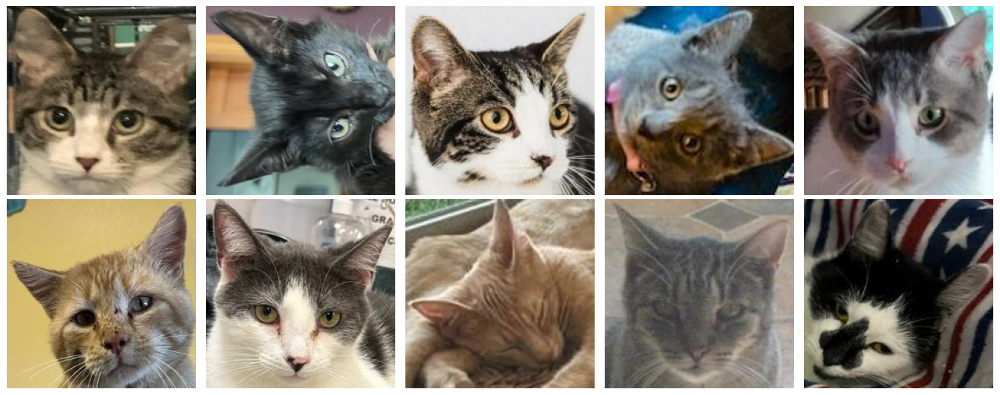

In [ ]:
show_df_cats(df_face, 10)

# Triplet generator
A la red deben entrar tripletas de ancla, positiva y negativa.
El ancla es la imagen del gato con el que se compara
El positivo es una otra imagen del gato ancla pero diferente
El negativo es una imagen de otro gato

<img src="https://i.imgur.com/VKV4a7l.png" alt="alt text"/>


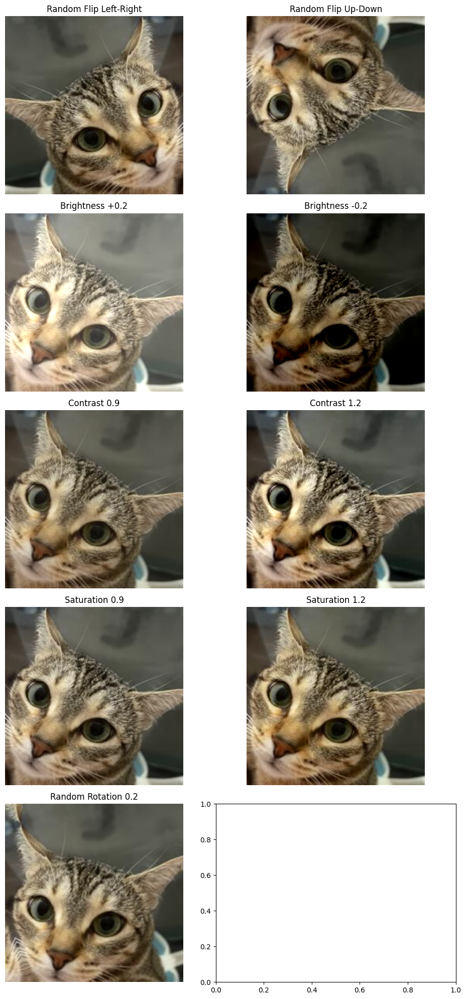

In [ ]:
#@title  Ver transformaciones de data augmentation
# ver las transformaciones que se le van a hacer
cat = df_face.iloc[14]
image = np.frombuffer(cat["image"], dtype=np.uint8)
image = image.reshape((224,224,3))
# Check if the image is already normalized
if image.min() < 0 or image.max() > 1:
  # normalizing image
  image = image / 255.

image = image.reshape(1, 224, 224, 3)
image = tf.convert_to_tensor(image, dtype=tf.float32)


# Define transformations
transformations = [
    ("Random Flip Left-Right", tf.image.random_flip_left_right(image)),
    ("Random Flip Up-Down", tf.image.random_flip_up_down(image)),
    ("Brightness +0.2", tf.image.adjust_brightness(image, 0.2)),
    ("Brightness -0.2", tf.image.adjust_brightness(image, -0.2)),
    ("Contrast 0.9", tf.image.adjust_contrast(image, 0.9)),
    ("Contrast 1.2", tf.image.adjust_contrast(image, 1.2)),
    ("Saturation 0.9", tf.image.adjust_saturation(image, 0.9)),
    ("Saturation 1.2", tf.image.adjust_saturation(image, 1.2)),
    ("Random Rotation 0.2", tf.keras.layers.RandomRotation(factor=0.2, fill_mode='reflect')(image))
]

# Plotting
num_transformations = len(transformations)
rows = (num_transformations + 1) // 2  # Ensure enough rows for all transformations
fig, axs = plt.subplots(rows, 2, figsize=(10, 4 * rows))

for i, (title, transformed_image) in enumerate(transformations):
    row = i // 2
    col = i % 2
    transformed_image = tf.clip_by_value(transformed_image, 0.0, 1.0)
    axs[row, col].imshow(np.squeeze(transformed_image.numpy()))
    axs[row, col].set_title(title)
    axs[row, col].axis('off')

# Adjust layout and show plot
plt.tight_layout()
plt.show()

In [5]:
# Data augmentation function
def data_augmentation(anchor, positive, negative):
    def augment(image):
        image = tf.image.random_flip_left_right(image)
        image = tf.image.random_flip_up_down(image)
        image = tf.image.random_brightness(image, max_delta=0.2)
        image = tf.image.random_contrast(image, lower=0.9, upper=1.2)
        image = tf.image.random_saturation(image, lower=0.9, upper=1.2)
        image = tf.keras.layers.RandomRotation(factor=0.2, fill_mode='reflect')(image)
        image = tf.clip_by_value(image, 0.0, 1.0)
        return image

    anchor = augment(anchor)
    positive = augment(positive)
    negative = augment(negative)
    return anchor, positive, negative


In [6]:
# Un generador simple de tripletes
class TripletGenerator:
    def __init__(self, df, augmentation = False):
        self.df = df
        self.augmentation = augmentation
        self.cats_ids = df["id"].unique()
        # dictionary with cat id and cat image
        self.cats_dictionary = df

    def get_next_element(self):
        # create an infinite generator
        while True:
            # sacar un gato de forma aleatoria
            anchor_cat = self.df.sample(n=1).iloc[0]
            while self.df[self.df["id"] == anchor_cat["id"]].shape[0] < 2:
              # Resample until an anchor cat with more than one image is found
              anchor_cat = self.df.sample(n=1).iloc[0]


            # sacar otra diferente foto de ese mismo gato
            positive_cat = self.df[(self.df["id"] == anchor_cat["id"]) & (self.df["image"] != anchor_cat["image"])].sample(n=1).iloc[0]
            # sacar una foto de un gato diferente
            negative_cat = self.df[self.df["id"] != anchor_cat["id"]].sample(n=1).iloc[0]

            anchorPhoto = self.get_cat(anchor_cat)
            positivePhoto = self.get_cat(positive_cat)
            negativePhoto = self.get_cat(negative_cat)

            if self.augmentation:
                anchorPhoto, positivePhoto, negativePhoto = data_augmentation(anchorPhoto, positivePhoto, negativePhoto)

            # yield the anchor, positive, and negative photos
            yield (anchorPhoto, positivePhoto, negativePhoto)


    def get_cat(self, cat):
        #image = mpimg.imread(cat.image)
        image = np.frombuffer(cat.image, dtype=np.uint8)
        # Reshape the array to the original image shape
        image = image.reshape((224,224,3))

        # Check if the image is already normalized
        if image.min() < 0 or image.max() > 1:
            # normalizing image
            image = image / 255.

        return image

In [15]:
trainTripletGenerator = TripletGenerator(train_df, augmentation=True)
valTripletGenerator = TripletGenerator(val_df)

tensor_shape = (MODEL_IMAGE_SIZE, MODEL_IMAGE_SIZE, 3)

trainTfDataset = tf.data.Dataset.from_generator(
    generator=trainTripletGenerator.get_next_element,
    output_signature=(
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
    )
)

valTfDataset = tf.data.Dataset.from_generator(
    generator=valTripletGenerator.get_next_element,
    output_signature=(
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
    )
)


In [16]:
# batch size and the buffer size
BATCH_SIZE = 3
BUFFER_SIZE = BATCH_SIZE * 2
# define autotune
AUTO = tf.data.AUTOTUNE

trainDs = (trainTfDataset
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)
valDs = (valTfDataset
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

In [17]:
#@title Codigo de chatgpt para visualizar los triplets
def visualize_triplets(batch):
    anchor_batch, positive_batch, negative_batch = batch

    # Iterate through each triplet in the batch
    for i in range(anchor_batch.shape[0]):
        anchor = anchor_batch[i]
        positive = positive_batch[i]
        negative = negative_batch[i]

        # Plot the images
        plt.figure(figsize=(9, 3))

        plt.subplot(1, 3, 1)
        plt.imshow(anchor)
        plt.title('Anchor')
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(positive)
        plt.title('Positive')
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(negative)
        plt.title('Negative')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

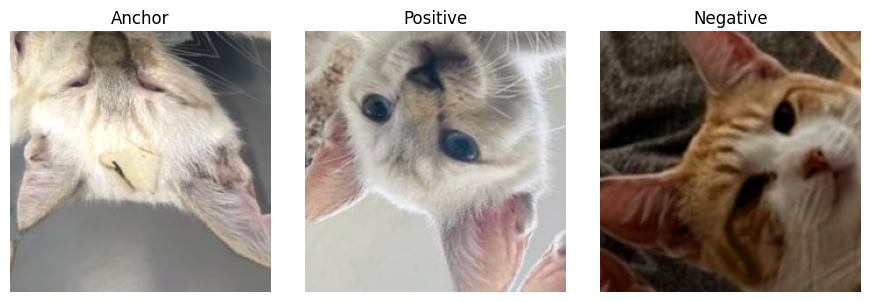

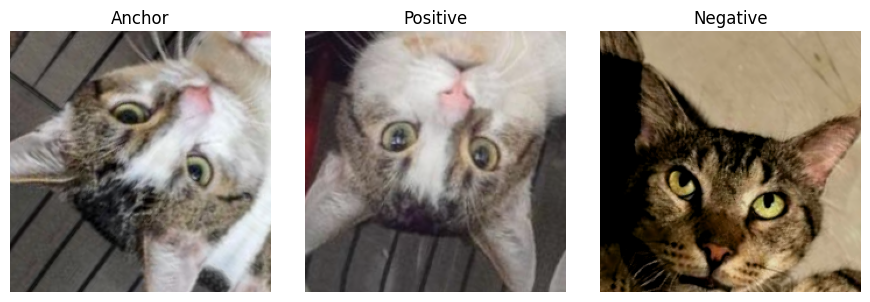

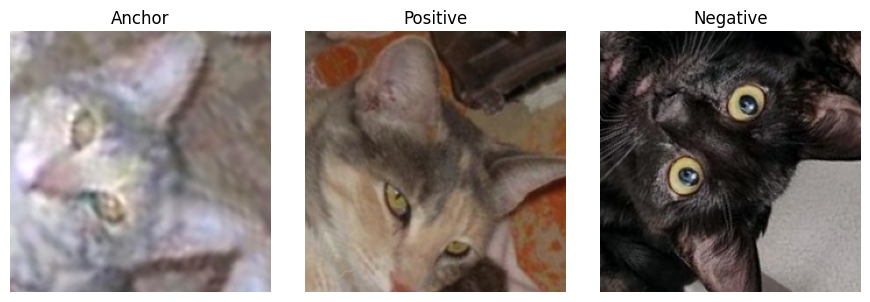

In [18]:
# Example usage to visualize the first batch of images
for batch in trainDs.take(1):  # Take the first batch
    visualize_triplets(batch)

# Modelo del vector embebido: EfficientNetB2 (preentrenado con imagenet)
<img src="https://skyengine.ai/se/images/blog/Architecture-of-EfficientNet-B0-with-MBConv-as-Basic-building-blocks.png" alt="alt text"/>

In [12]:
from tensorflow.keras.applications.efficientnet import EfficientNetB2, preprocess_input as efficientNetPreprocessInput

# Load the EfficientNetB2 model with pre-trained ImageNet weights (excluding top layers)
efficientNet_model = EfficientNetB2(weights='imagenet', include_top=False, input_shape=(224,224,3))


In [ ]:
efficientNet_model.summary()

Model: "efficientnetb2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_11 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 rescaling_2 (Rescaling)     (None, 224, 224, 3)          0         ['input_11[0][0]']            
                                                                                                  
 normalization_1 (Normaliza  (None, 224, 224, 3)          7         ['rescaling_2[0][0]']         
 tion)                                                                                            
                                                                                                  
 rescaling_3 (Rescaling)     (None, 224, 224, 3)          0         ['normalization_1

1/1 [==============================] - 0s 314ms/step


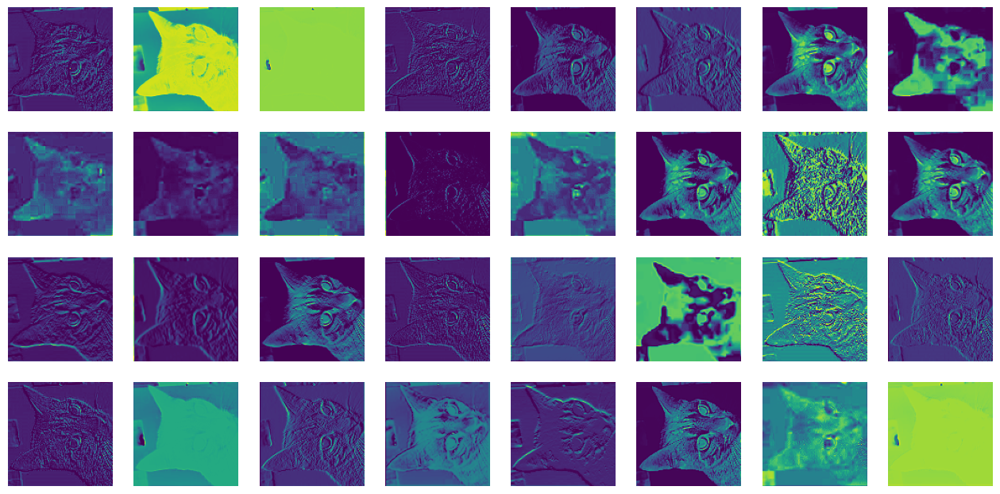

In [76]:
#@title Visualizar features
def visualizar_features(model, layer_name, cat):
  # Obtener la capa deseada para visualizar las activaciones
  intermediate_layer_model = keras.models.Model(inputs=model.input, outputs=model.get_layer(layer_name).output)

  # Cargar y preprocesar una imagen de entrada
  img = get_cat(cat)
  img_array = keras.preprocessing.image.img_to_array(img)
  img_array = tf.expand_dims(img_array, axis=0)
  img_array = keras.applications.resnet.preprocess_input(img_array)

  # Obtener las activaciones de la capa para la imagen de entrada
  activations = intermediate_layer_model.predict(img_array)

  # Visualizar las activaciones
  plt.figure(figsize=(16, 16))
  num_filters = min(64, activations.shape[-1])
  for i in range(num_filters):
      plt.subplot(8, 8, i + 1)
      plt.imshow(activations[0, :, :, i], cmap='viridis')
      plt.axis('off')

cat = df_face.iloc[10]
layer_name = 'block1a_se_excite'
visualizar_features(efficientNet_model, layer_name, cat)

# Modelo siames
<img src="https://i.imgur.com/eLOy4Q3.png" alt="alt text"/>

In [9]:
def get_embedding_module(imageSize, baseCnn, base_Cnn_preprocesor, embedding_size):
    # construct the input layer and pass the inputs through a
    # pre-processing layer
    inputs = keras.Input(imageSize + (3,))
    x = base_Cnn_preprocesor(inputs)

    # pass the pre-processed inputs through the base cnn and get the
    # extracted features from the inputs
    extractedFeatures = baseCnn(x)
    # pass the extracted features through a number of trainable layers
    x = keras.layers.GlobalAveragePooling2D()(extractedFeatures)
    outputs = keras.layers.Dense(units=embedding_size, activation = "relu")(x)
    # build the embedding model and return it
    embedding = keras.Model(inputs, outputs, name="embedding")
    return embedding

In [10]:
def get_siamese_network(imageSize, embeddingModel):
    # build the anchor, positive and negative input layer
    anchorInput = keras.Input(name="anchor", shape=imageSize + (3,))
    positiveInput = keras.Input(name="positive", shape=imageSize + (3,))
    negativeInput = keras.Input(name="negative", shape=imageSize + (3,))

    # embed the anchor, positive and negative images
    anchorEmbedding = embeddingModel(anchorInput)
    positiveEmbedding = embeddingModel(positiveInput)
    negativeEmbedding = embeddingModel(negativeInput)
    # build the siamese network and return it
    siamese_network = keras.Model(
        inputs=[anchorInput, positiveInput, negativeInput],
        outputs=[anchorEmbedding, positiveEmbedding, negativeEmbedding]
    )
    return siamese_network


**Función de pérdida triple**
Esta función de pérdida tiene como objetivo asegurar que las muestras positivas estén más cerca del ancla que las muestras negativas.

$$
l_{tri}= max(0, \epsilon (f(x_i) -f(x_i^-))^2 - (f(x_i) - f(x_i^+))^2 + \alpha )
$$

Una definicion mas simplificada:

$$
\text{loss} = \max((\text{distancia_mismo_gato} - \text{distancia_otro_gato}) + \text{margen}, 0.0)
$$


Si la diferencia entre las distancias positivas y negativas (más el margen) es menor que cero, la pérdida es cero, es decir que no hay penalización. De lo contrario, la pérdida aumenta linealmente con la diferencia. Esto fomenta que el modelo aprenda representaciones de manera que:

$$
\text{distancia_mismo_gato} + \text{margen} < \text{distancia_otro_gato}
$$

<img src="https://upload.wikimedia.org/wikipedia/commons/f/f2/The-Triplet-loss-in-cosine-similarity.png" alt="alt text"/>
(Imagen de wikipedia)


**Métricas**

Adicionalmente incluí dos metricas para monitorear el desempeño del modelo

Accuracy 1: Cantidad de predicciones correctas dentro del margen
$$   \text{correct predictions} = \sum_{i=1}^{N} \mathbb{I}((\text{apDistance}[i] < \alpha) \land (\text{anDistance}[i] > \alpha))
  $$

Accuracy 2: cantidad de predicciones correctas basandose en si la distancia positiva es menor a la negativa
$$   \text{correct predictions} = \sum_{i=1}^{N} \mathbb{I}(\text{apDistance}[i] < \text{anDistance})
$$




In [11]:
# modelo con la red siamesa
class SiameseModel(keras.Model):
    def __init__(self, network, margin, lossTracker, accuracyTracker, accuracyTracker2):
        super().__init__()
        self.network = network
        self.margin = margin
        self.lossTracker = lossTracker
        self.accuracyTracker = accuracyTracker
        self.accuracyTracker2 = accuracyTracker2


    def _compute_distance(self, anchorEmbedding, positiveEmbedding, negativeEmbedding):
        # calculate the anchor to positive and negative distance
        apDistance = tf.reduce_sum(
            tf.square(anchorEmbedding - positiveEmbedding), axis=-1
        )
        anDistance = tf.reduce_sum(
            tf.square(anchorEmbedding - negativeEmbedding), axis=-1
        )

        # return the distances
        return (apDistance, anDistance)

    def get_embeddings(self, inputs):
        (anchor, positive, negative) = inputs
        # embed the images
        embeddings = self.network((anchor, positive, negative))
        anchorEmbedding = embeddings[0]
        positiveEmbedding = embeddings[1]
        negativeEmbedding = embeddings[2]
        return (anchorEmbedding, positiveEmbedding, negativeEmbedding)

    def _compute_loss(self, anchorEmbedding, positiveEmbedding, negativeEmbedding):
      apDistance = tf.reduce_sum(tf.square(anchorEmbedding - positiveEmbedding), axis=-1)
      anDistance = tf.reduce_sum(tf.square(anchorEmbedding - negativeEmbedding), axis=-1)
      l_triplet = apDistance - anDistance
      loss = tf.maximum(l_triplet + self.margin , 0.0)
      return loss

    def _compute_accuracy(self, apDistance, anDistance):
      # cantidad de predicciones donde positivo < margin y negativo > margin
      correct_predictions = tf.reduce_sum(tf.cast((apDistance < self.margin) & (anDistance > self.margin), tf.float32))
      # proporcion de predicciones correctas buenas_distancias / cantidad de distancias calculadas
      accuracy = correct_predictions / tf.cast(tf.shape(apDistance)[0], tf.float32)
      return accuracy

    def _compute_accuracy2(self, apDistance, anDistance):

      correct_predictions = tf.reduce_sum(tf.cast((apDistance < anDistance), tf.float32))
      # proporcion de predicciones correctas buenas_distancias / cantidad de distancias calculadas
      accuracy = correct_predictions / tf.cast(tf.shape(apDistance)[0], tf.float32)
      return accuracy


    def call(self, inputs):
        # Compute the distance between the anchor and positive, negative images
        anchorEmbedding, positiveEmbedding, negativeEmbedding = self.get_embeddings(inputs)
        apDistance, anDistance = self._compute_distance(anchorEmbedding, positiveEmbedding, negativeEmbedding)
        return apDistance, anDistance

    def train_step(self, inputs):
        with tf.GradientTape() as tape:
            anchorEmbedding, positiveEmbedding, negativeEmbedding = self.get_embeddings(inputs)
            apDistance, anDistance = self._compute_distance(anchorEmbedding, positiveEmbedding, negativeEmbedding)
            loss = self._compute_loss(anchorEmbedding, positiveEmbedding, negativeEmbedding)

        gradients = tape.gradient(loss, self.network.trainable_variables)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_variables))

        self.lossTracker.update_state(loss)
        accuracy = self._compute_accuracy(apDistance, anDistance)
        self.accuracyTracker.update_state(accuracy)
        accuracy2 = self._compute_accuracy2(apDistance, anDistance)
        self.accuracyTracker2.update_state(accuracy2)

        return {"loss": self.lossTracker.result(),
                "accuracy": self.accuracyTracker.result(),
                "accuracy2": self.accuracyTracker2.result()}

    def test_step(self, inputs):
        anchorEmbedding, positiveEmbedding, negativeEmbedding = self.get_embeddings(inputs)
        apDistance, anDistance = self._compute_distance(anchorEmbedding, positiveEmbedding, negativeEmbedding)
        loss = self._compute_loss(anchorEmbedding, positiveEmbedding, negativeEmbedding)

        self.lossTracker.update_state(loss)
        accuracy = self._compute_accuracy(apDistance, anDistance)
        self.accuracyTracker.update_state(accuracy)
        accuracy2 = self._compute_accuracy2(apDistance, anDistance)
        self.accuracyTracker2.update_state(accuracy2)

        return {"loss": self.lossTracker.result(),
                "accuracy": self.accuracyTracker.result(),
                "accuracy2": self.accuracyTracker2.result()}


    def save_weights(self, filepath, overwrite=True, save_format=None):
        self.network.save_weights(filepath)

    def save_model(self, filepath, overwrite=True,  include_optimizer=True, save_format=None):
        self.network.save(filepath)

    def load_weights(self, filepath):
        self.network.load_weights(filepath)

    def get_model(self):
      return self.network

    @property
    def metrics(self):
        return [self.lossTracker]

In [13]:
IMAGE_SIZE = (MODEL_IMAGE_SIZE, MODEL_IMAGE_SIZE)

margin = 0.4 # distancia de separacion de los vectores
d = 64 # embedding size

embeddingModel = get_embedding_module(IMAGE_SIZE, efficientNet_model, efficientNetPreprocessInput, d)
embeddingModel.compile(optimizer=keras.optimizers.Adam(0.001))

siamese_network = get_siamese_network(IMAGE_SIZE, embeddingModel)

siameseModel = SiameseModel(
	network = siamese_network,
	margin=margin,
	lossTracker=keras.metrics.Mean(name="loss"),
	accuracyTracker = keras.metrics.Mean(name="accuracy"),
	accuracyTracker2 = keras.metrics.Mean(name="accuracy"),
)

In [ ]:
embeddingModel.summary()

Model: "embedding"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetb2 (Functional  (None, 7, 7, 1408)        7768569   
 )                                                               
                                                                 
 global_average_pooling2d_1  (None, 1408)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dense_1 (Dense)             (None, 64)                90176     
                                                                 
Total params: 7858745 (29.98 MB)
Trainable params: 7791170 (29.72 MB)
Non-trainable params: 67575 (263.97 KB)
_________________________________________________________________


In [ ]:
siameseModel.load_weights("/content/drive/MyDrive/proyecto_ia_gaticos/modelo_siames_best1.h5")

In [ ]:
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
# compile the siamese model
LEARNING_RATE = 0.0001
STEPS_PER_EPOCH = 32
VALIDATION_STEPS = 32
EPOCHS = 25

# batch size and the buffer size
BATCH_SIZE = 32
BUFFER_SIZE = BATCH_SIZE * 2
# define autotune
AUTO = tf.data.AUTOTUNE
trainDs = (trainTfDataset
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)
valDs = (valTfDataset
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

siameseModel.compile(
	optimizer=keras.optimizers.Adam(LEARNING_RATE),
	weighted_metrics=[] # silence warning
)


In [ ]:
# train and validate the siamese model
history = siameseModel.fit(
	trainDs,
	steps_per_epoch=STEPS_PER_EPOCH,
	validation_data=valDs,
	validation_steps=VALIDATION_STEPS,
	epochs=EPOCHS
)

[INFO] training the siamese model...
Epoch 1/25
32/32 [==============================] - 180s 3s/step - loss: 0.1631 - accuracy: 0.0236 - accuracy2: 0.1915 - val_loss: 0.1797 - val_accuracy: 0.0627 - val_accuracy2: 0.2375
Epoch 2/25
32/32 [==============================] - 100s 3s/step - loss: 0.1630 - accuracy: 0.0758 - accuracy2: 0.2527 - val_loss: 0.1355 - val_accuracy: 0.1107 - val_accuracy2: 0.2916
Epoch 3/25
32/32 [==============================] - 123s 4s/step - loss: 0.1692 - accuracy: 0.1217 - accuracy2: 0.3045 - val_loss: 0.1611 - val_accuracy: 0.1467 - val_accuracy2: 0.3361
Epoch 4/25
32/32 [==============================] - 118s 4s/step - loss: 0.1699 - accuracy: 0.1552 - accuracy2: 0.3464 - val_loss: 0.1561 - val_accuracy: 0.1791 - val_accuracy2: 0.3743
Epoch 5/25
32/32 [==============================] - 111s 4s/step - loss: 0.1694 - accuracy: 0.1869 - accuracy2: 0.3832 - val_loss: 0.1660 - val_accuracy: 0.2069 - val_accuracy2: 0.4069
Epoch 6/25
32/32 [====================

In [ ]:
siameseModel.save_weights("mi_modelo_mas_gaticos_sabado1.h5")

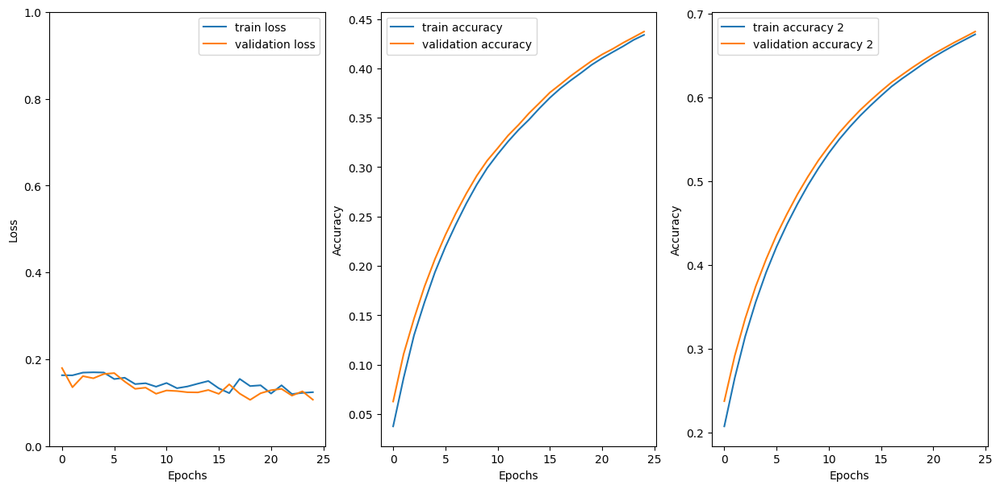

In [ ]:
plt.figure(figsize=(15,7))
plt.subplot(1,3,1)
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.ylim(0, 1.0)
plt.legend()

plt.subplot(1,3,2)
plt.plot(history.history['accuracy'], label='train accuracy')
plt.plot(history.history['val_accuracy'], label='validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1,3,3)
plt.plot(history.history['accuracy2'], label='train accuracy 2')
plt.plot(history.history['val_accuracy2'], label='validation accuracy 2')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

In [ ]:
history2 = siameseModel.fit(
	trainDs,
	steps_per_epoch=STEPS_PER_EPOCH,
	validation_data=valDs,
	validation_steps=VALIDATION_STEPS,
	epochs=EPOCHS
)

Epoch 1/25
32/32 [==============================] - 122s 4s/step - loss: 0.1305 - accuracy: 0.4387 - accuracy2: 0.6801 - val_loss: 0.1177 - val_accuracy: 0.4427 - val_accuracy2: 0.6844
Epoch 2/25
32/32 [==============================] - 122s 4s/step - loss: 0.1358 - accuracy: 0.4438 - accuracy2: 0.6857 - val_loss: 0.1051 - val_accuracy: 0.4476 - val_accuracy2: 0.6897
Epoch 3/25
32/32 [==============================] - 138s 4s/step - loss: 0.1244 - accuracy: 0.4490 - accuracy2: 0.6910 - val_loss: 0.1428 - val_accuracy: 0.4521 - val_accuracy2: 0.6946
Epoch 4/25
32/32 [==============================] - 110s 4s/step - loss: 0.1145 - accuracy: 0.4532 - accuracy2: 0.6960 - val_loss: 0.1259 - val_accuracy: 0.4569 - val_accuracy2: 0.6995
Epoch 5/25
32/32 [==============================] - 103s 3s/step - loss: 0.1378 - accuracy: 0.4578 - accuracy2: 0.7007 - val_loss: 0.1105 - val_accuracy: 0.4608 - val_accuracy2: 0.7041
Epoch 6/25
32/32 [==============================] - 119s 4s/step - loss: 0.

In [ ]:
siameseModel.save_weights("mi_modelo_mas_gaticos_sabado2.h5")

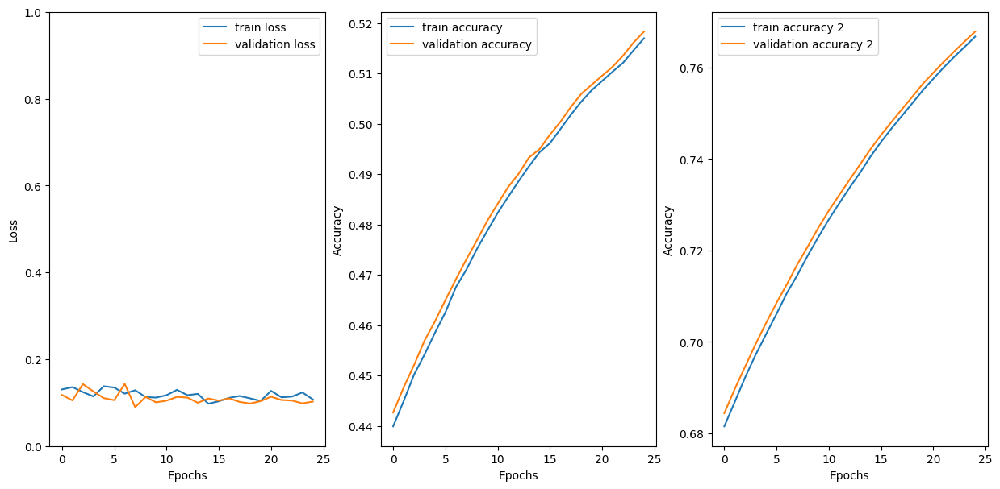

In [ ]:
plt.figure(figsize=(15,7))
plt.subplot(1,3,1)
plt.plot(history2.history['loss'], label='train loss')
plt.plot(history2.history['val_loss'], label='validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.ylim(0, 1.0)
plt.legend()

plt.subplot(1,3,2)
plt.plot(history2.history['accuracy'], label='train accuracy')
plt.plot(history2.history['val_accuracy'], label='validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1,3,3)
plt.plot(history2.history['accuracy2'], label='train accuracy 2')
plt.plot(history2.history['val_accuracy2'], label='validation accuracy 2')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

In [ ]:
history3 = siameseModel.fit(
	trainDs,
	steps_per_epoch=STEPS_PER_EPOCH,
	validation_data=valDs,
	validation_steps=VALIDATION_STEPS,
	epochs=EPOCHS
)

Epoch 1/25
32/32 [==============================] - 108s 3s/step - loss: 0.1027 - accuracy: 0.5189 - accuracy2: 0.7684 - val_loss: 0.0957 - val_accuracy: 0.5205 - val_accuracy2: 0.7701
Epoch 2/25
32/32 [==============================] - 101s 3s/step - loss: 0.1051 - accuracy: 0.5210 - accuracy2: 0.7706 - val_loss: 0.1045 - val_accuracy: 0.5225 - val_accuracy2: 0.7722
Epoch 3/25
32/32 [==============================] - 127s 4s/step - loss: 0.1099 - accuracy: 0.5229 - accuracy2: 0.7726 - val_loss: 0.0978 - val_accuracy: 0.5240 - val_accuracy2: 0.7741
Epoch 4/25
32/32 [==============================] - 112s 4s/step - loss: 0.1100 - accuracy: 0.5241 - accuracy2: 0.7746 - val_loss: 0.1082 - val_accuracy: 0.5251 - val_accuracy2: 0.7760
Epoch 5/25
32/32 [==============================] - 99s 3s/step - loss: 0.1165 - accuracy: 0.5254 - accuracy2: 0.7765 - val_loss: 0.0844 - val_accuracy: 0.5272 - val_accuracy2: 0.7780
Epoch 6/25
32/32 [==============================] - 97s 3s/step - loss: 0.09

In [ ]:
siameseModel.save_weights("mi_modelo_mas_gaticos_sabado3.h5")

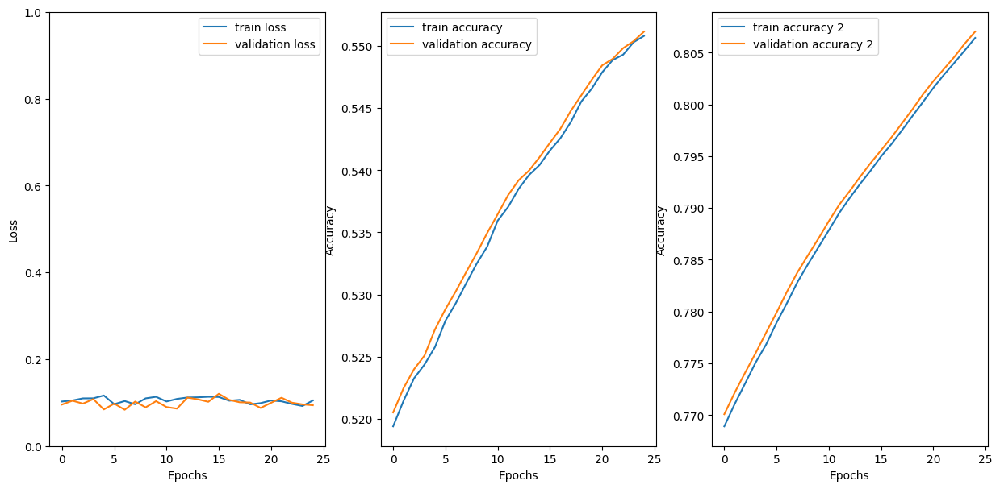

In [ ]:
plt.figure(figsize=(15,7))
plt.subplot(1,3,1)
plt.plot(history3.history['loss'], label='train loss')
plt.plot(history3.history['val_loss'], label='validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.ylim(0, 1.0)
plt.legend()

plt.subplot(1,3,2)
plt.plot(history3.history['accuracy'], label='train accuracy')
plt.plot(history3.history['val_accuracy'], label='validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1,3,3)
plt.plot(history3.history['accuracy2'], label='train accuracy 2')
plt.plot(history3.history['val_accuracy2'], label='validation accuracy 2')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

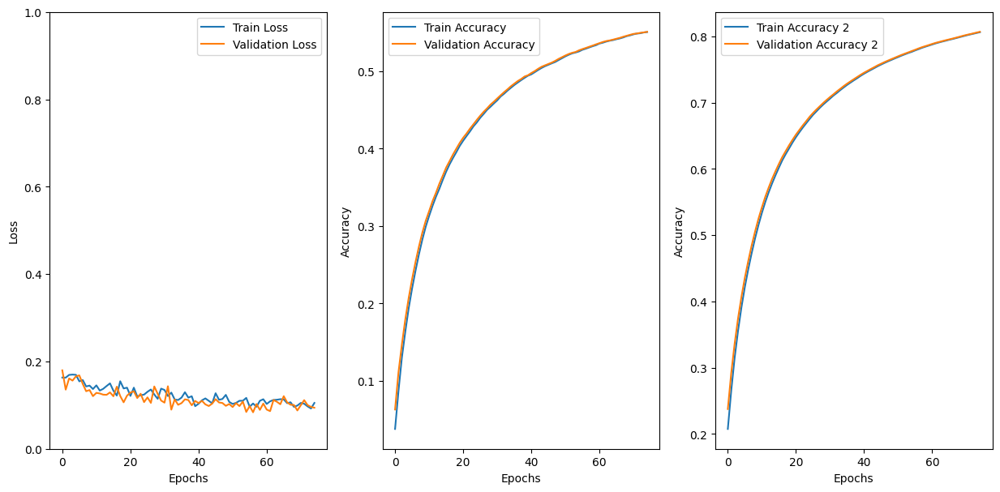

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have three history objects: history1, history2, history3
histories = [history, history2, history3]

# Initialize lists to store combined metrics
combined_train_loss = []
combined_val_loss = []
combined_train_accuracy = []
combined_val_accuracy = []
combined_train_accuracy2 = []
combined_val_accuracy2 = []

# Combine the metrics from all histories
for history in histories:
    combined_train_loss.extend(history.history['loss'])
    combined_val_loss.extend(history.history['val_loss'])
    combined_train_accuracy.extend(history.history['accuracy'])
    combined_val_accuracy.extend(history.history['val_accuracy'])
    combined_train_accuracy2.extend(history.history['accuracy2'])
    combined_val_accuracy2.extend(history.history['val_accuracy2'])

# Plot the combined histories
plt.figure(figsize=(15, 7))

# Loss
plt.subplot(1, 3, 1)
plt.plot(combined_train_loss, label='Train Loss')
plt.plot(combined_val_loss, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.ylim(0, 1.0)
plt.legend()

# Accuracy
plt.subplot(1, 3, 2)
plt.plot(combined_train_accuracy, label='Train Accuracy')
plt.plot(combined_val_accuracy, label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Accuracy 2
plt.subplot(1, 3, 3)
plt.plot(combined_train_accuracy2, label='Train Accuracy 2')
plt.plot(combined_val_accuracy2, label='Validation Accuracy 2')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()


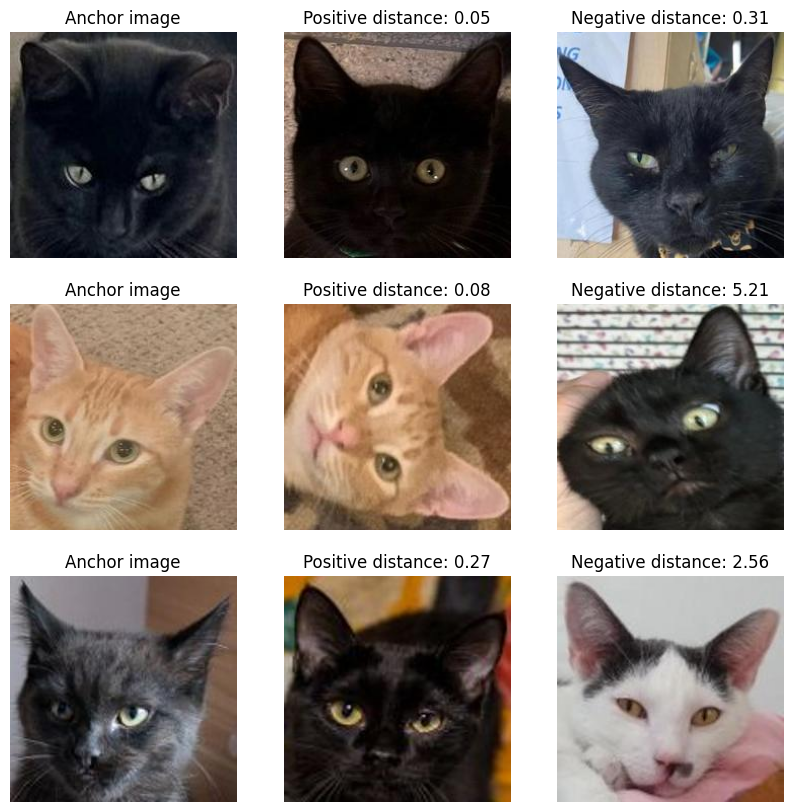

In [ ]:
(anchor, positive, negative) = next(iter(valDs))
(apDistance, anDistance) = siameseModel((anchor, positive, negative))
plt.figure(figsize=(10, 10))
rows = 3
for row in range(rows):
	plt.subplot(rows, 3, row * 3 + 1)
	plt.imshow(anchor[row])
	plt.axis("off")
	plt.title("Anchor image")
	plt.subplot(rows, 3, row * 3 + 2)
	plt.imshow(positive[row])
	plt.axis("off")
	plt.title(f"Positive distance: {apDistance[row]:0.2f}")
	plt.subplot(rows, 3, row * 3 + 3)
	plt.imshow(negative[row])
	plt.axis("off")
	plt.title(f"Negative distance: {anDistance[row]:0.2f}")

# Probando el modelo!

In [ ]:
# cargar pesos
siameseModel.load_weights("/content/drive/MyDrive/mi_modelo2.h5")

In [29]:
import random
random.seed(15)

In [30]:
test_df = val_df
print("Imagenes de testeo: ", test_df.shape[0])
print("Gatos de testeo: ", test_df["id"].unique().shape[0])

Imagenes de testeo:  1914
Gatos de testeo:  567


## Identificar el gato de un gato diferentes
Para esta prueba creo un dataset de parejas de gatos. Un gato es el ancla y el otro es con el que se compara a ver si son el mismo o no.
Hay igual probabilidad de tener un gato igual a uno diferente. Para no tener sesgos

In [28]:
# obtener gato y normalizarlo si todavia no lo esta
def process_cat(image):
  image = np.frombuffer(image, dtype=np.uint8)
  # Reshape the array to the original image shape
  image = image.reshape((224,224,3))

  # Check if the image is already normalized
  if image.min() < 0 or image.max() > 1:
      # normalizing image
      image = image / 255.
  return image

In [31]:
anchor_photos = []
compare_photos = []
labels = []

# por cada gato sacamos una foto del mismo gato o de uno diferente con igual probabilidad
for cat in test_df["id"].unique():
  anchor_cat = test_df[test_df["id"] == cat ].sample(n = 1).iloc[0]

  positive = test_df[(test_df["id"] == anchor_cat["id"]) & (test_df["image"] != anchor_cat["image"])].sample(n=1).iloc[0]
  negative_cat = test_df[test_df["id"] != anchor_cat["id"]].sample(n=1).iloc[0]

  # hay igual probabilidad de seleccionar un gato positivo o uno negativp
  same_cat = random.choice([True, False])
  if same_cat:
    compare_photo = process_cat(positive["image"])
    label = 1;

  else:
    compare_photo = process_cat(negative_cat["image"])
    label = 0;

  anchorPhoto = process_cat(anchor_cat["image"])
  anchor_photos.append(anchorPhoto)
  compare_photos.append(compare_photo)
  labels.append(label)

# Convert lists to NumPy arrays
anchor_photos = np.array(anchor_photos)
compare_photos = np.array(compare_photos)
labels = np.array(labels)

In [32]:
print("Shape of anchor_photos:", anchor_photos.shape)
print("Shape of compare_photos:", compare_photos.shape)
print("Shape of labels:", labels.shape)

print("Same cat samples: ", np.count_nonzero(labels == 1)) # Use np.count_nonzero to count occurrences
print("Different cat samples: ", np.count_nonzero(labels == 0)) # Use np.count_nonzero to count occurrences

Shape of anchor_photos: (567, 224, 224, 3)
Shape of compare_photos: (567, 224, 224, 3)
Shape of labels: (567,)
Same cat samples:  272
Different cat samples:  295


In [ ]:
# calcular distancias entre todas las parejas de gatos
# se evalua la distancia maxima que pueden tener los gatos para pertenecer a la misma clase
distances = []

for i in range(0, labels.shape[0]):
  anchor = anchor_photos[i].reshape(1,224,224,3)
  image = compare_photos[i].reshape(1,224,224,3)
  anchor = tf.convert_to_tensor(anchor, dtype=tf.float32)
  image = tf.convert_to_tensor(image, dtype=tf.float32)
  distance, _ = siameseModel((image , anchor, image))
  distance = distance.numpy()[0]
  distances.append(distance)


In [ ]:
# voy a cambiar el index ese
distancia_maxima = 0.455

predictions =[]
for i in range(0, labels.shape[0]):
  distance = distances[i]
  if distance < distancia_maxima:
    prediction = 1
  else:
    prediction = 0

  predictions.append(prediction)

predictions = np.asarray(predictions)

Accuracy: 0.8060
Precision: 0.8062
Recall: 0.8050


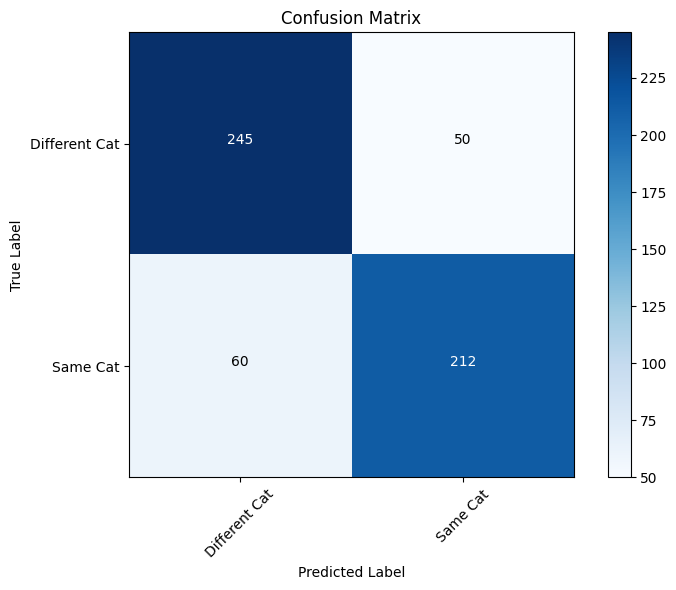

In [ ]:
# imprimir matriz de confusión
# voy a cambiar el index ese
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix

# Compute accuracy
accuracy = accuracy_score(labels, predictions)
print(f'Accuracy: {accuracy:.4f}')

# Compute precision
precision = precision_score(labels, predictions, average='macro')
print(f'Precision: {precision:.4f}')

# Compute recall
recall = recall_score(labels, predictions, average='macro')
print(f'Recall: {recall:.4f}')

# Compute confusion matrix
cm = confusion_matrix(labels, predictions)

# # Define class labels
class_labels = ['Different Cat', 'Same Cat']

# Plot confusion matrix
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(class_labels))
plt.xticks(tick_marks, class_labels, rotation=45)
plt.yticks(tick_marks, class_labels)

fmt = 'd'
thresh = cm.max() / 2.
for i, j in np.ndindex(cm.shape):
    plt.text(j, i, format(cm[i, j], fmt),
             horizontalalignment="center",
             color="white" if cm[i, j] > thresh else "black")

plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.tight_layout()
plt.show()

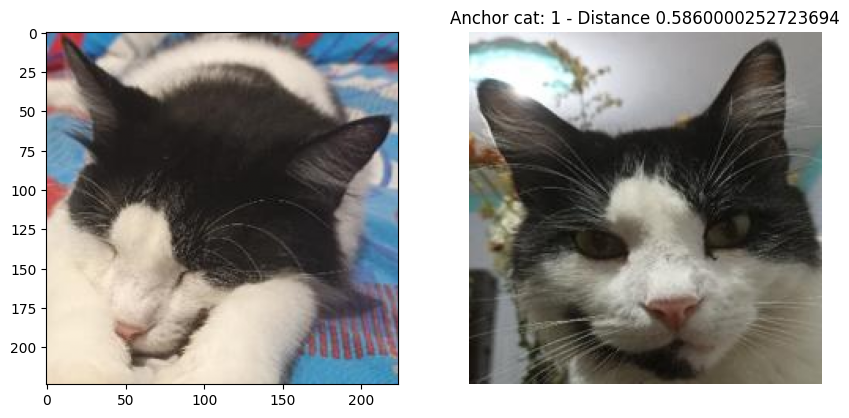

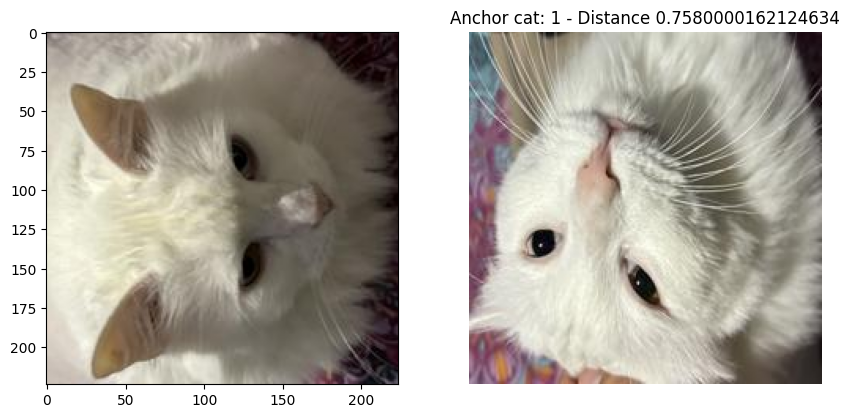

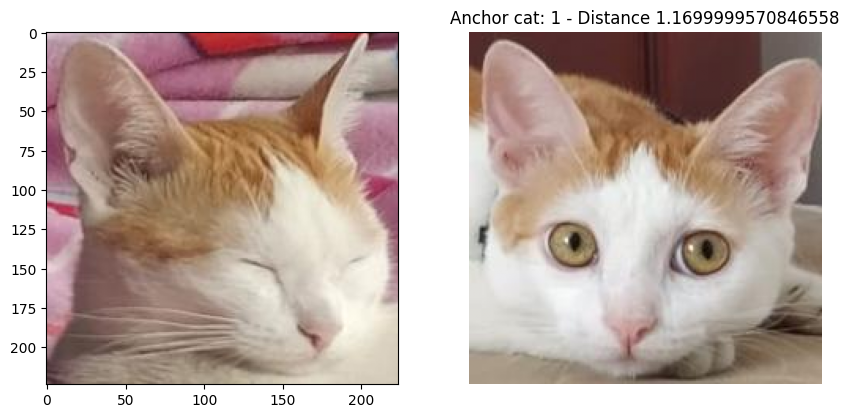

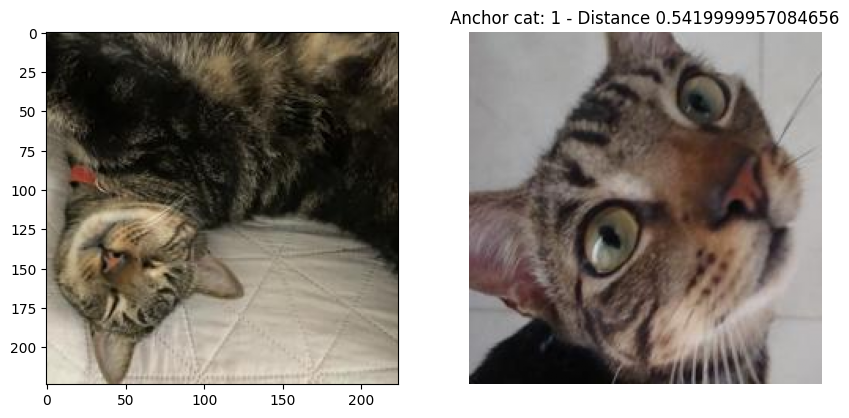

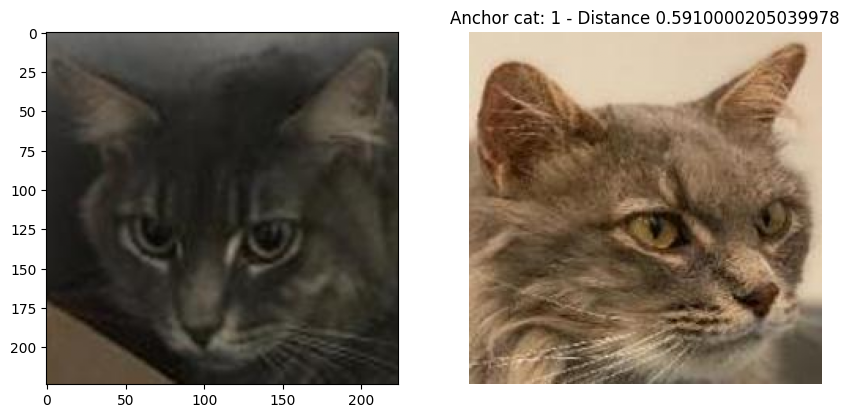

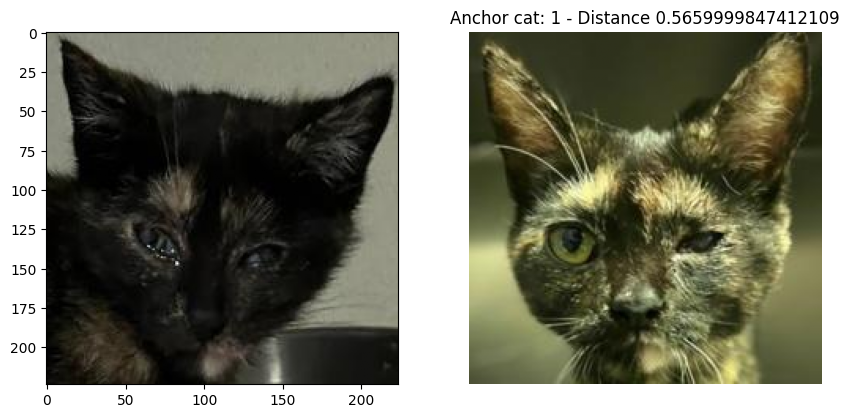

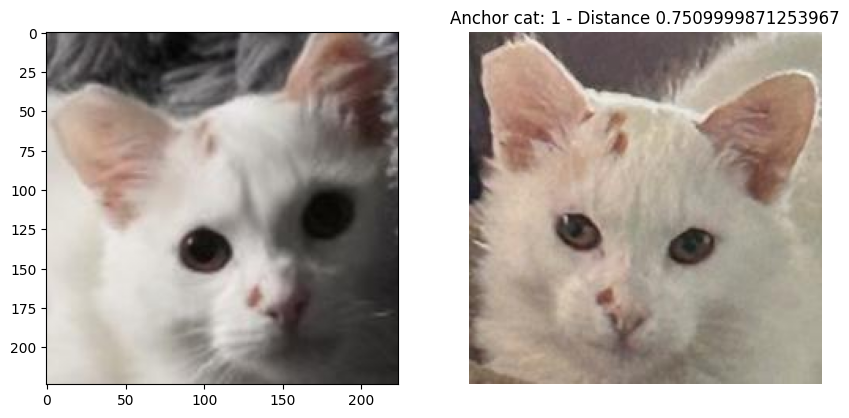

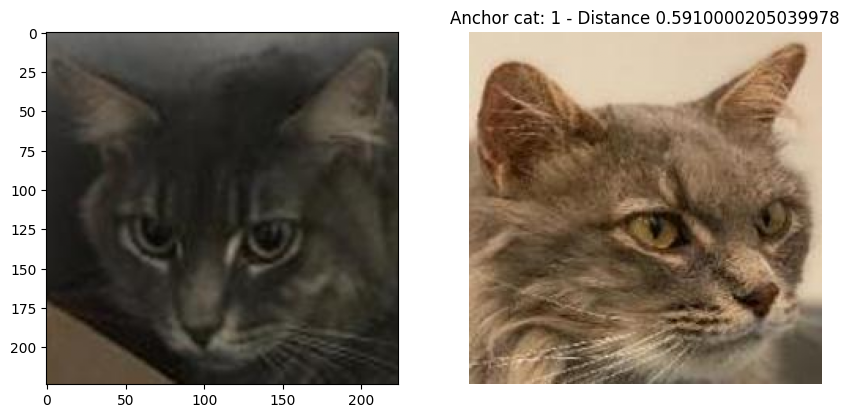

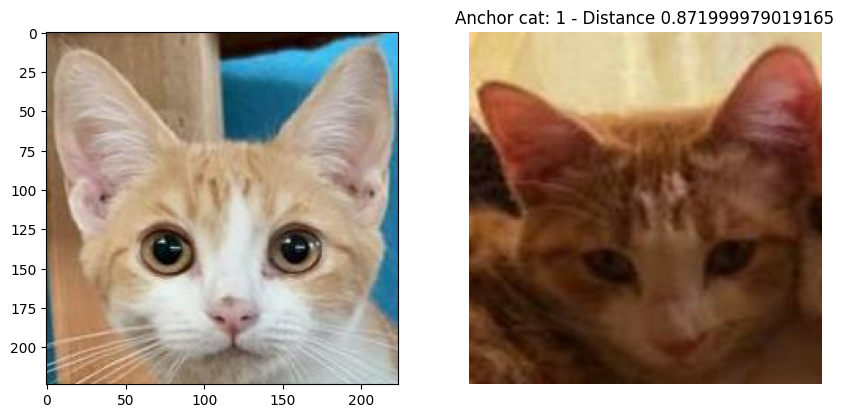

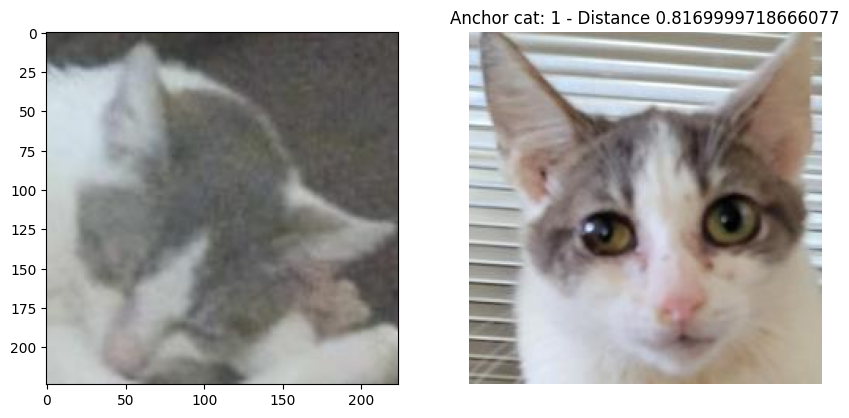

In [ ]:
# printing 10 false negatives
max = 10
count = 0
for i, (anchor,image, label, prediction)  in enumerate(zip(anchor_photos, compare_photos, labels, predictions)):
  if prediction == 0 and label == 1:
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(anchor)
    plt.subplot(1,2,2)
    plt.imshow(image)
    plt.title(f"Anchor cat: {labels[i]} - Distance {round(distances[i],3)}")
    plt.axis("off")
    count = count +1

    if count == max:
      break

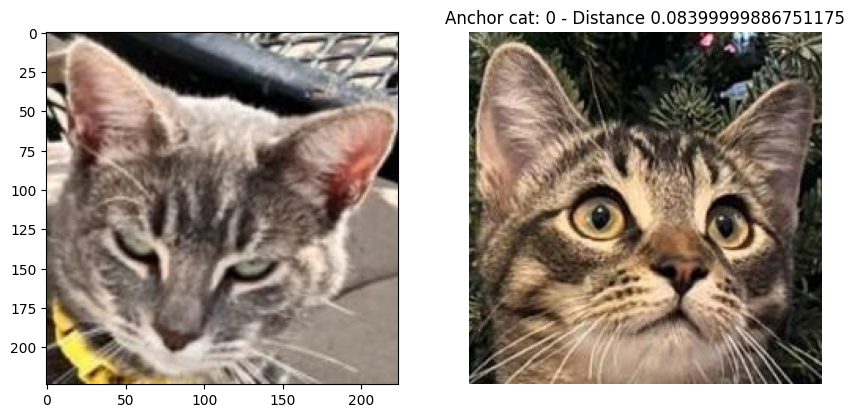

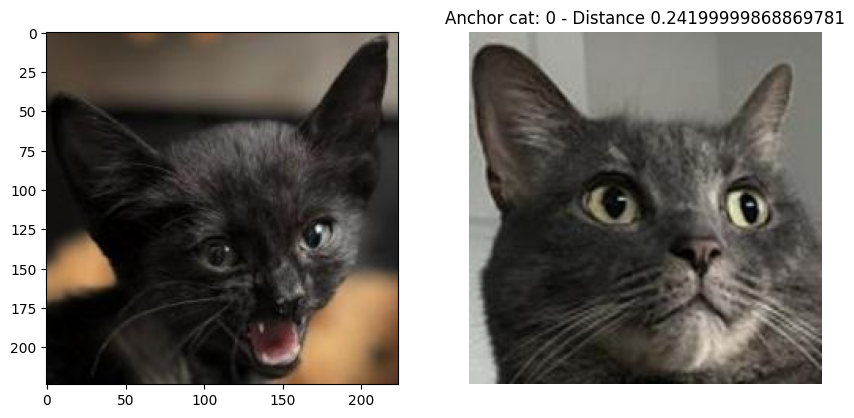

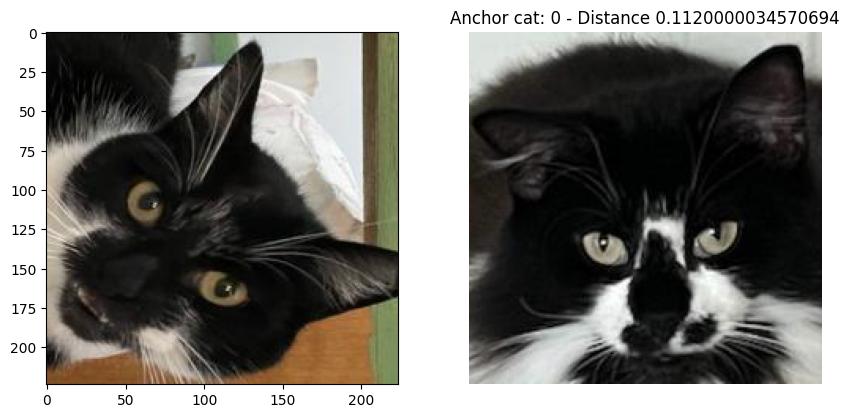

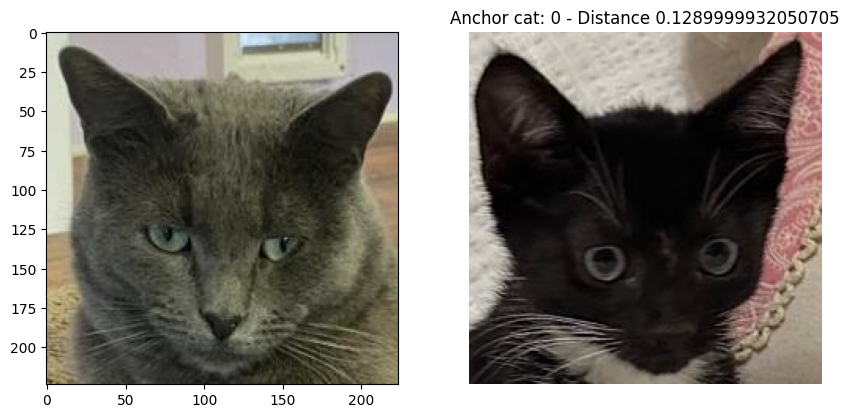

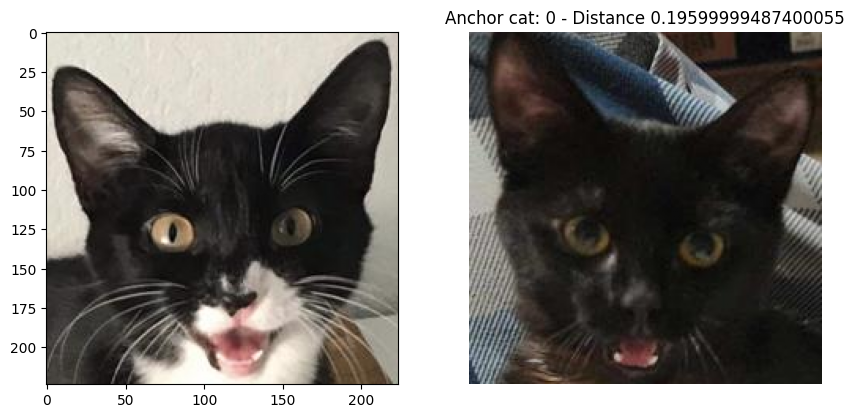

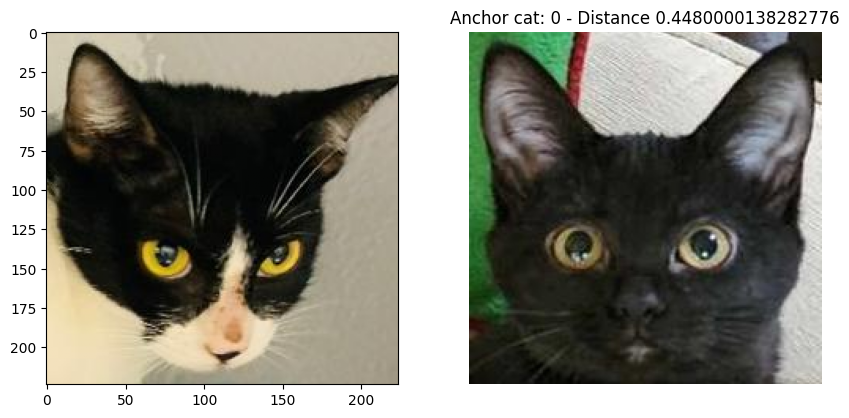

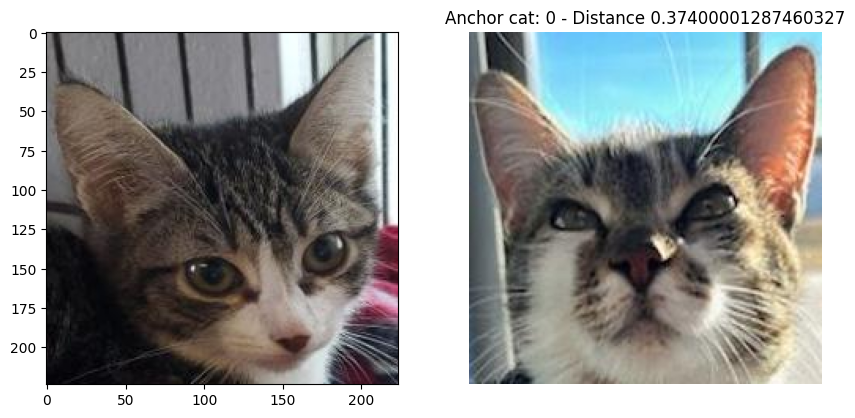

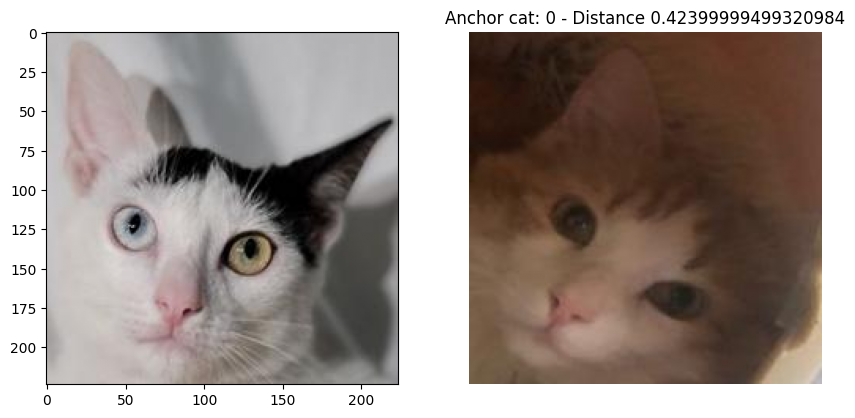

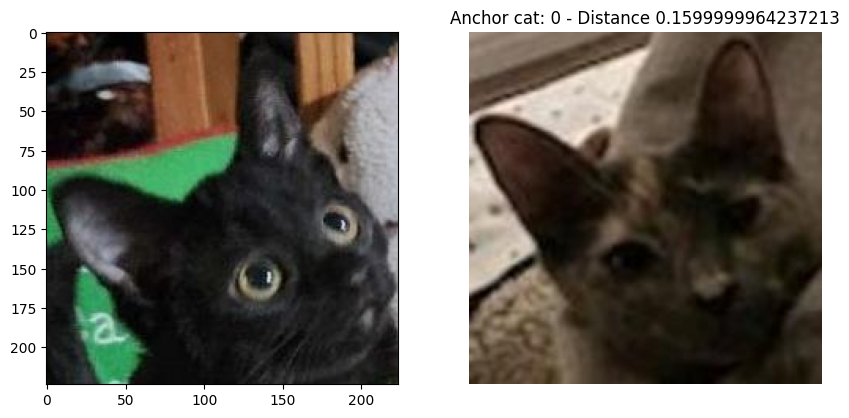

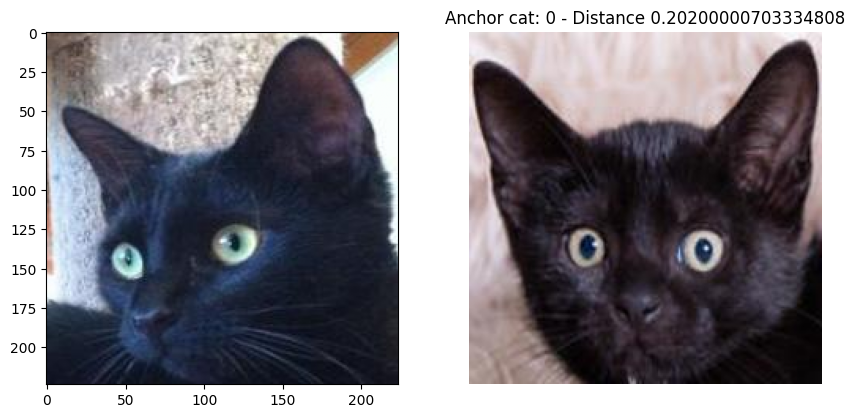

In [ ]:
# printing 10 false positives
max = 10
count = 0
for i, (anchor,image, label, prediction)  in enumerate(zip(anchor_photos, compare_photos, labels, predictions)):
  if prediction == 1 and label == 0:
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(anchor)
    plt.subplot(1,2,2)
    plt.imshow(image)
    rounded_distance = round(distances[i], 3)
    plt.title(f"Anchor cat: {labels[i]} - Distance {rounded_distance}")
    plt.axis("off")
    count = count +1

  if count == max:
    break

## Rank 10 accuracy:
Como el objetivo del modelo es encontrar gatos perdidos, voy a ver que tan bueno es en encontrar el gato entre una población mucho más grande.

Veamos que tan bueno es el modelo en encontrar gatos entre las 10 mejores predicciones (es decir las más cercanas) del modelo.

In [ ]:
print("Cantidad de imagenes: ", val_df.shape[0])

Cantidad de imagenes:  1914


In [ ]:
# Como hay muchas imagenes en el dataset de testeo, solo lo voy a hacer con 250 gatos
unique_ids = val_df["id"].unique()
sampled_ids = np.random.choice(unique_ids, size=250, replace=False)
test_df = val_df[val_df["id"].isin(sampled_ids)]

In [ ]:
print("Cantidad de imagenes a procesar: ", test_df.shape[0])

Cantidad de imagenes a procesar:  1914


In [ ]:
# Codigo para obtener los embeddings de todas las imagenes de testeo
i = 0
images_numpy = []
embeddings = []

while i < test_df.shape[0]:
  if i >= test_df.shape[0] - 2:
    break
  cat1 = test_df.iloc[i]
  cat2 = test_df.iloc[i+1]
  cat3 = test_df.iloc[i+2]

  image1 = process_cat(cat1["image"])
  image2 = process_cat(cat2["image"])
  image3 = process_cat(cat3["image"])

  images_numpy.append(image1)
  images_numpy.append(image2)
  images_numpy.append(image3)

  image1 = image1.reshape(1,224,224,3)
  image2 = image2.reshape(1,224,224,3)
  image3 = image3.reshape(1,224,224,3)

  image1 = tf.convert_to_tensor(image1, dtype=tf.float32)
  image2 = tf.convert_to_tensor(image2, dtype=tf.float32)
  image3 = tf.convert_to_tensor(image3, dtype=tf.float32)

  embedding1, embedding2, embedding3 = siameseModel.get_embeddings((image1 , image2, image3))
  embedding1 = embedding1.numpy()
  embedding2 = embedding2.numpy()
  embedding3 = embedding3.numpy()

  embeddings.append(embedding1)
  embeddings.append(embedding2)
  embeddings.append(embedding3)

  i = i + 3


# y ahora los que faltaron
while i < test_df.shape[0]:
  cat = test_df.iloc[i]
  image = process_cat(cat["image"])
  images_numpy.append(image)
  image = image.reshape(1,224,224,3)
  image = tf.convert_to_tensor(image, dtype=tf.float32)
  embedding, _ ,_  = siameseModel.get_embeddings((image, image, image))
  embedding = embedding.numpy()
  embeddings.append(embedding)
  i = i + 1

In [ ]:
np.save('embeddings_testeo.npy',embeddings)
np.save('ids_testeo.npy',test_df["id"].values)
np.save('cats_testeo.npy',test_df["image"].values)

In [ ]:
import numpy as np
embeddings = np.load('embeddings_testeo.npy')
ids_t = np.load('ids_testeo.npy', allow_pickle=True)
cats_t = np.load('cats_testeo.npy', allow_pickle=True)

In [ ]:
import pandas as pd
test_df = pd.DataFrame({
    'id': ids_t,
    'image': cats_t
})

In [ ]:
embeddings = np.array(embeddings)
embeddings = embeddings.reshape(1914,64)


labels = test_df["id"].values

print(embeddings.shape)
print(labels.shape)

(1914, 64)
(1914,)


In [ ]:
# Compute distances to each embedding
unique_cats = test_df["id"].unique()
anchor_cats = []
rank = 10 # how many best distances
results = []

for cat in unique_cats:
  indexes = [i for i, name in enumerate(labels) if name == cat]
  #idx = random.choice(indexes)
  idx = indexes[0] # para que siempre sea el mismo
  anchor_cats.append(idx)
  print(cat, idx)
  cat_embedding = embeddings[idx]
  distances = []

  for index_emb, embedding in enumerate(embeddings):

    if index_emb != idx: # no con la misma foto del gato
      d = np.sum(np.square(cat_embedding - embedding))
    else:
      d = -1 # Assign -1 for the same photo

    distances.append(d)

  distances = np.array(distances)
  sorted_indices = np.argsort(distances)
  sorted_distances = distances[sorted_indices]

  # omitiendo el primero porque es la misma imagen
  sorted_indices = sorted_indices[1:rank]
  sorted_distances = sorted_distances[1:rank]

  prediction_vector = [int(item in indexes) for item in  sorted_indices]

  results.append((idx, cat, sorted_indices, sorted_distances, prediction_vector))


8-Yuki 0
11-Oreo 3
13-Chimuelo 6
18-Michu 9
19-Atenea 11
23-Sancho 13
20-Berta 15
26-tito 18
27-copito 20
Betty_54475280 23
Benny_71354595 26
Bekki_71458705 30
Bart_71354596 33
Banana_71261343 37
Baby SavITF_70922787 40
Ashley_53756664 44
Allie Kay_54476286 49
45211288_54476236 52
45211248_54476311 54
Ruby_58064128 56
Rosemary  ITF_69739061 61
Ringo_54476266 65
Pumpkin_54475228 67
Precious_54475200 69
Piston0010_71367268 71
Pirate_71514289 74
Peter _57582090 79
PealITF_71028623 83
Paulina_50817143 85
Patches_54475130 88
Panthera_71630617 90
Paco_54476313 92
Obsidian_54476305 95
Noir_54475330 97
Nellie_54476222 100
Mozart_69446604 103
Moth_71641111 108
Moss_70158258 111
MONICA_55509827 117
Mimi_69446608 123
Max_54476256 125
Maverick_70567636 128
Mary_70566886 131
Lunchbox_70927874 133
Luna_54476254 136
Luna_54475239 139
Lucy_59878011 141
Loverboy_70661299 146
Lou_71043419 151
Lizbeth_54475129 154
Kyo_69446552 156
Kibou_59878010 162
Joel_54476322 166
Jean Grey_59782224 168
Jane_69808293 

In [ ]:
print(unique_cats.shape)

(567,)


In [ ]:
# check out rank10 results
rank10_predictions = [t[-1] for t in results]
correct_predictions = 0

# Check each vector in rank10_predictions
for vector in rank10_predictions:
    if any(elem == 1 for elem in vector):
        correct_predictions += 1

print(f"Number of correct predictions: {correct_predictions}")
print(f"Rank10 accuracy: {round(correct_predictions / len(results) * 100, 3)}")

Number of correct predictions: 142
Rank10 accuracy: 25.044


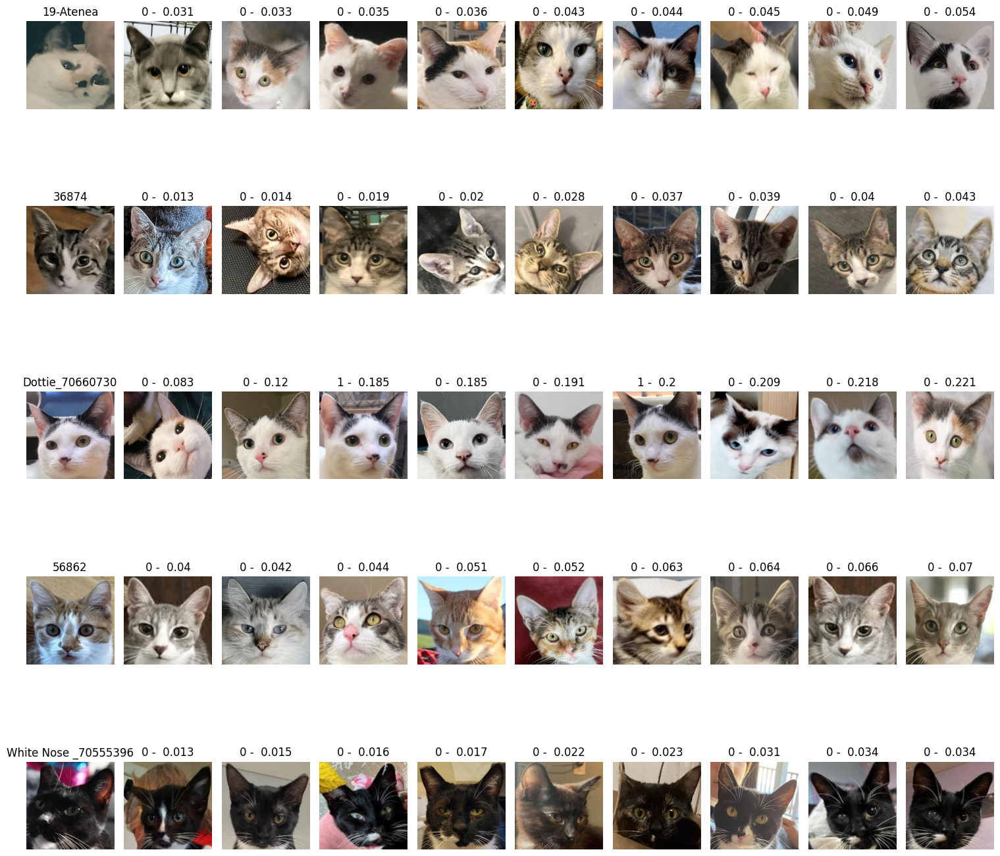

In [ ]:
import random
import matplotlib.pyplot as plt
# printing results
def display_image(image, label, ax):
    ax.imshow(image)
    ax.set_title(label)
    ax.axis('off')

num_results = 5
results_sample = random.sample(results, num_results)

fig, axs = plt.subplots(num_results, 10, figsize=(15, 15))
for i, (idx, cat, sorted_indices, sorted_distances, prediction_vector) in enumerate(results_sample):
  cat_image = test_df.iloc[idx]
  cat_image = process_cat(cat_image["image"])
  display_image(cat_image, f"{cat}", axs[i, 0])

  for j, (cat_match, distance, prediction) in enumerate(zip(sorted_indices, sorted_distances, prediction_vector)):
    match_image = test_df.iloc[cat_match]
    match_image = process_cat(match_image["image"])
    display_image(match_image, f"{prediction} -  {round(distance,3)}", axs[i, j + 1])

plt.tight_layout()
plt.show()

# Triplet mining: hard negatives

In [13]:
# Load the image arrays and IDs
train = np.load("/content/drive/MyDrive/proyecto_ia_gaticos/train.npy", allow_pickle=True)
val = np.load("/content/drive/MyDrive/proyecto_ia_gaticos/val.npy",  allow_pickle=True)

# indices de los negativos mas similares
hardest_negatives_index = np.load("/content/drive/MyDrive/proyecto_ia_gaticos/hardest_negatives30.npy",  allow_pickle=True)
distance_negatives = np.load("/content/drive/MyDrive/proyecto_ia_gaticos/distancias_negativos30.npy",  allow_pickle=True)

In [14]:
train_df = pd.DataFrame(train)
val_df = pd.DataFrame(val)

hardest_negatives_index = [arr.tolist() for arr in hardest_negatives_index]
train_df = pd.DataFrame({
    'id': train_df[0],
    'image': train_df[1],
    'hardest': hardest_negatives_index,
})
val_df.rename(columns={0: 'id', 1: 'image'}, inplace=True)

In [7]:
train_df.head()

,id,image,hardest
0,2-Boris,"b'\x87I4\x86H3\x86E/\x85E,\x85A*\x85B\'\x87A\'...","[248, 323, 326, 362, 1581, 142, 468, 324, 299,..."
1,2-Boris,b'\xc6l:\xc8n<\xcap>\xccr@\xcbq?\xc9o=\xc6k<\x...,"[1757, 498, 626, 1683, 851, 2228, 1391, 104, 2..."
2,2-Boris,b'\xc7\xcb\xd4\xc7\xcb\xd4\xc8\xcc\xd5\xc8\xcc...,"[2127, 900, 2128, 567, 642, 2228, 638, 1801, 2..."
3,4-Ramón (Moncho),b'\x8fu\\\x8crY\x8bqZ\x8ds\\\x90wa\x8eu_\x85oZ...,"[1972, 1586, 174, 2448, 23, 317, 281, 289, 187..."
4,4-Ramón (Moncho),b'z\x82\x85}\x85\x88\x82\x8a\x8d\x87\x8f\x92\x...,"[2308, 2526, 450, 1402, 1405, 679, 23, 1526, 3..."


In [8]:
val_df.head()

,id,image
0,8-Yuki,b'\xe5\xf1\xf1\xe6\xf2\xf2\xe9\xf1\xf3\xea\xef...
1,8-Yuki,b'\x9f\xa1\xa0\x9e\xa0\x9f\x9d\x9f\x9e\x9c\x9e...
2,8-Yuki,b'\x87f\x9bwk\x9bYy\xa2N\x84\xa8Q\x88\xaf`\x80...
3,11-Oreo,b'\x84\x88\x8e\x84\x88\x8e\x84\x88\x8e\x84\x88...
4,11-Oreo,b'+43LRPWXS^YSdWN\x8bym\x9c\x82utXJ|\\M\x86i[t...


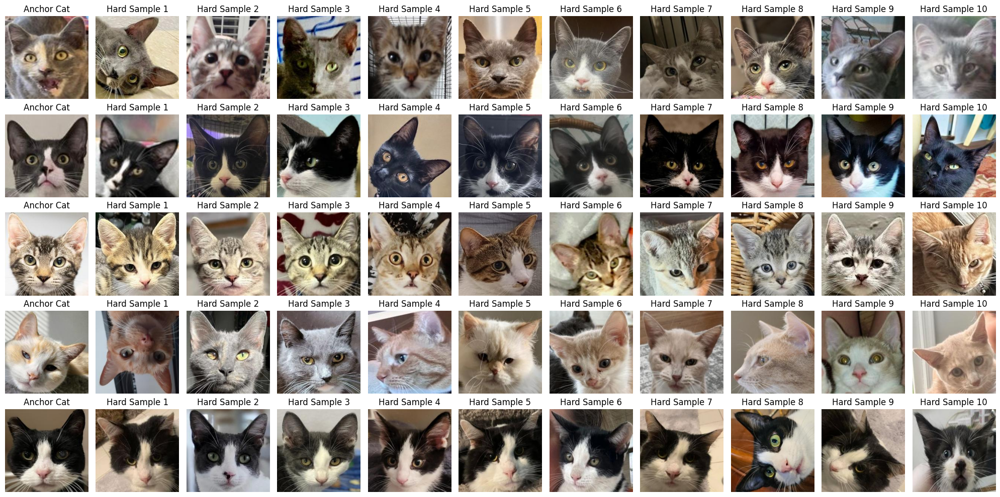

In [14]:
random_cats = train_df.sample(n=5)
num_hard_samples = 10

# Create subplots: 5 rows (for 5 random cats) and num_hard_samples + 1 columns (anchor cat + hard samples)
fig, axes = plt.subplots(5, num_hard_samples + 1, figsize=(20, 10))

# Iterate through each selected cat
for row_idx, (_, cat) in enumerate(random_cats.iterrows()):
    # Show the anchor cat in the first column of the current row
    img = get_cat(cat)
    axes[row_idx, 0].imshow(img)
    axes[row_idx, 0].set_title("Anchor Cat")
    axes[row_idx, 0].axis('off')

    # Iterate through the hardest samples for the selected cat
    for col_idx, hard_index in enumerate(cat["hardest"][:num_hard_samples]):
        hard_cat = train_df.iloc[hard_index]
        img = get_cat(hard_cat)
        axes[row_idx, col_idx + 1].imshow(img)
        axes[row_idx, col_idx + 1].set_title(f"Hard Sample {col_idx + 1}")
        axes[row_idx, col_idx + 1].axis('off')

# Adjust layout
plt.tight_layout()
plt.show()

In [19]:
# Un generador simple de tripletes
class HardTripletGenerator:
    def __init__(self, df, augmentation = False):
        self.df = df
        self.augmentation = augmentation
        self.cats_ids = df["id"].unique()
        # dictionary with cat id and cat image
        self.cats_dictionary = df

    def get_next_element(self):
        # create an infinite generator
        while True:
            # sacar un gato de forma aleatoria
            anchor_cat = self.df.sample(n=1).iloc[0]
            while self.df[self.df["id"] == anchor_cat["id"]].shape[0] < 2:
              # Resample until an anchor cat with more than one image is found
              anchor_cat = self.df.sample(n=1).iloc[0]


            # sacar otra diferente foto de ese mismo gato
            positive_cat = self.df[(self.df["id"] == anchor_cat["id"]) & (self.df["image"] != anchor_cat["image"])].sample(n=1).iloc[0]
            # sacar una foto de un gato diferente
            negative_cat_index = random.choice(anchor_cat["hardest"])
            negative_cat = self.df.iloc[negative_cat_index]


            anchorPhoto = self.get_cat(anchor_cat)
            positivePhoto = self.get_cat(positive_cat)
            negativePhoto = self.get_cat(negative_cat)

            if self.augmentation:
                anchorPhoto, positivePhoto, negativePhoto = data_augmentation(anchorPhoto, positivePhoto, negativePhoto)

            # yield the anchor, positive, and negative photos
            yield (anchorPhoto, positivePhoto, negativePhoto)


    def get_cat(self, cat):
        #image = mpimg.imread(cat.image)
        image = np.frombuffer(cat.image, dtype=np.uint8)
        # Reshape the array to the original image shape
        image = image.reshape((224,224,3))

        # Check if the image is already normalized
        if image.min() < 0 or image.max() > 1:
            # normalizing image
            image = image / 255.

        return image

In [20]:
trainHardTripletGenerator = HardTripletGenerator(train_df, augmentation=True)

# para el de validacion si normal
trainTripletGenerator = TripletGenerator(train_df, augmentation = True)
valTripletGenerator = TripletGenerator(val_df)

MODEL_IMAGE_SIZE = 224
tensor_shape = (MODEL_IMAGE_SIZE, MODEL_IMAGE_SIZE, 3)

trainHardTfDataset = tf.data.Dataset.from_generator(
    generator=trainHardTripletGenerator.get_next_element,
    output_signature=(
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
    )
)

trainTfDataset = tf.data.Dataset.from_generator(
    generator=trainTripletGenerator.get_next_element,
    output_signature=(
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
    )
)

valTfDataset = tf.data.Dataset.from_generator(
    generator=valTripletGenerator.get_next_element,
    output_signature=(
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
        tf.TensorSpec(shape=tensor_shape, dtype=tf.float32),
    )
)

In [21]:
# batch size and the buffer size
BATCH_SIZE = 3
BUFFER_SIZE = BATCH_SIZE * 2
# define autotune
AUTO = tf.data.AUTOTUNE

trainDs = (trainHardTfDataset
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)
valDs = (valTfDataset
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)

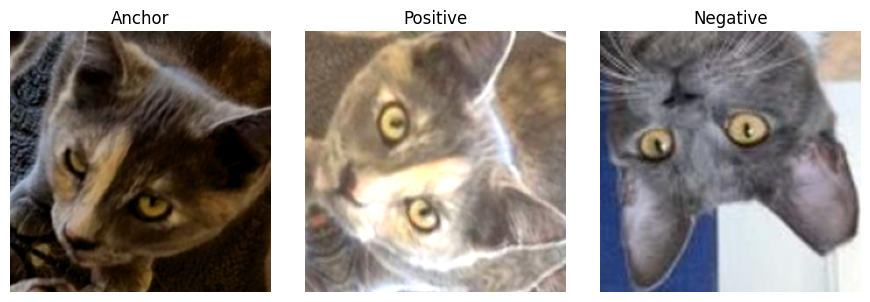

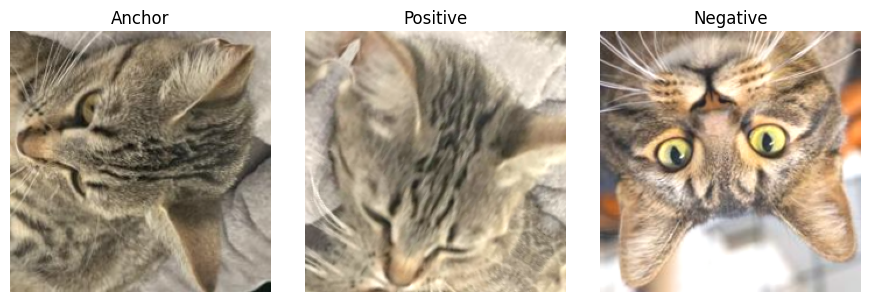

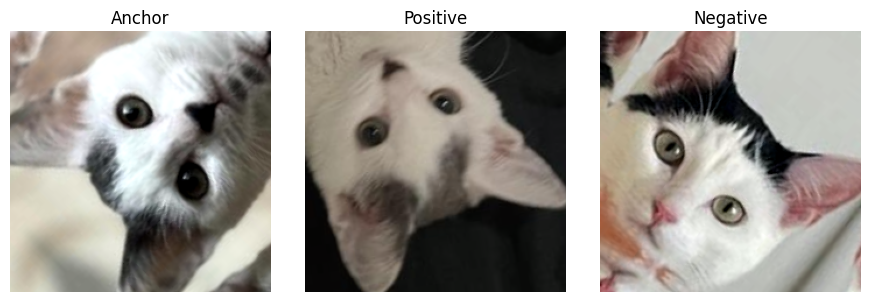

In [22]:
# Example usage to visualize the first batch of images
for batch in trainDs.take(1):  # Take the first batch
    visualize_triplets(batch)

In [23]:
IMAGE_SIZE = (MODEL_IMAGE_SIZE, MODEL_IMAGE_SIZE)

margin = 0.4 # distancia de separacion de los vectores
d = 64 # embedding size

embeddingModel = get_embedding_module(IMAGE_SIZE, efficientNet_model, efficientNetPreprocessInput, d)
embeddingModel.compile(optimizer=keras.optimizers.Adam(0.001))

siamese_network = get_siamese_network(IMAGE_SIZE, embeddingModel)
siameseModel = SiameseModel(
	network = siamese_network,
	margin=margin,
	lossTracker=keras.metrics.Mean(name="loss"),
	accuracyTracker = keras.metrics.Mean(name="accuracy"),
	accuracyTracker2 = keras.metrics.Mean(name="accuracy"),
)
siameseModel.load_weights("/content/drive/MyDrive/proyecto_ia_gaticos/modelo_siames_best1.h5")

In [24]:
# compile the siamese model
LEARNING_RATE = 0.00001
STEPS_PER_EPOCH = 4
VALIDATION_STEPS = 32
EPOCHS = 5

# batch size and the buffer size
BATCH_SIZE = 8
BUFFER_SIZE = BATCH_SIZE * 2
# define autotune
AUTO = tf.data.AUTOTUNE
trainDs = (trainHardTfDataset
    .shuffle(BUFFER_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(AUTO)
)
valDs = (valTfDataset
    .batch(32)
    .prefetch(AUTO)
)

siameseModel.compile(
	optimizer=keras.optimizers.Adam(LEARNING_RATE),
	weighted_metrics=[] # silence warning
)

In [25]:
# train and validate the siamese model
history = siameseModel.fit(
	trainDs,
	steps_per_epoch=STEPS_PER_EPOCH,
	validation_data=valDs,
	validation_steps=VALIDATION_STEPS,
	epochs=20
)

Epoch 1/20
4/4 [==============================] - 108s 8s/step - loss: 0.5592 - accuracy: 0.0333 - accuracy2: 0.2208 - val_loss: 0.0896 - val_accuracy: 0.5877 - val_accuracy2: 0.8429
Epoch 2/20
4/4 [==============================] - 12s 4s/step - loss: 0.5384 - accuracy: 0.5458 - accuracy2: 0.7993 - val_loss: 0.0956 - val_accuracy: 0.6120 - val_accuracy2: 0.8411
Epoch 3/20
4/4 [==============================] - 10s 3s/step - loss: 0.5324 - accuracy: 0.5892 - accuracy2: 0.8194 - val_loss: 0.1023 - val_accuracy: 0.6094 - val_accuracy2: 0.8409
Epoch 4/20
4/4 [==============================] - 13s 4s/step - loss: 0.5210 - accuracy: 0.5949 - accuracy2: 0.8271 - val_loss: 0.1006 - val_accuracy: 0.6126 - val_accuracy2: 0.8414
Epoch 5/20
4/4 [==============================] - 11s 4s/step - loss: 0.4441 - accuracy: 0.6010 - accuracy2: 0.8347 - val_loss: 0.1110 - val_accuracy: 0.6111 - val_accuracy2: 0.8446
Epoch 6/20
4/4 [==============================] - 12s 4s/step - loss: 0.4919 - accuracy: 

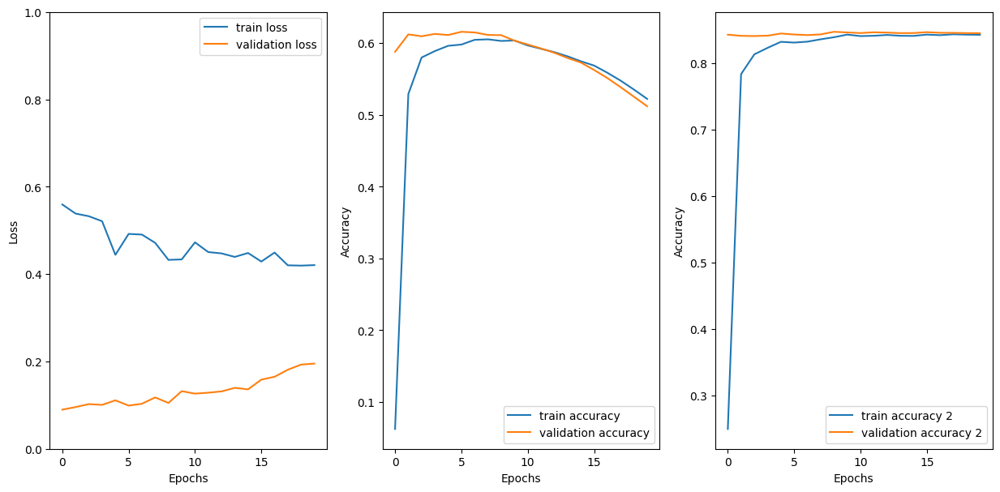

In [26]:
plt.figure(figsize=(15,7))
plt.subplot(1,3,1)
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.ylim(0, 1.0)
plt.legend()

plt.subplot(1,3,2)
plt.plot(history.history['accuracy'], label='train accuracy')
plt.plot(history.history['val_accuracy'], label='validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(1,3,3)
plt.plot(history.history['accuracy2'], label='train accuracy 2')
plt.plot(history.history['val_accuracy2'], label='validation accuracy 2')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.show()

In [27]:
siameseModel.save_weights("/content/drive/MyDrive/proyecto_ia_gaticos/modelo_mininghard.h5")

# Probando fine tuning

In [33]:
# calcular distancias entre todas las parejas de gatos
# se evalua la distancia maxima que pueden tener los gatos para pertenecer a la misma clase
distances = []

for i in range(0, labels.shape[0]):
  anchor = anchor_photos[i].reshape(1,224,224,3)
  image = compare_photos[i].reshape(1,224,224,3)
  anchor = tf.convert_to_tensor(anchor, dtype=tf.float32)
  image = tf.convert_to_tensor(image, dtype=tf.float32)
  distance, _ = siameseModel((image , anchor, image))
  distance = distance.numpy()[0]
  distances.append(distance)


In [46]:
# imprimir matriz de confusión
# voy a cambiar el index ese
distancia_maxima = 0.10

predictions =[]
for i in range(0, labels.shape[0]):
  distance = distances[i]
  if distance < distancia_maxima:
    prediction = 1
  else:
    prediction = 0

  predictions.append(prediction)

predictions = np.asarray(predictions)

Accuracy: 0.8219
Precision: 0.8226
Recall: 0.8229


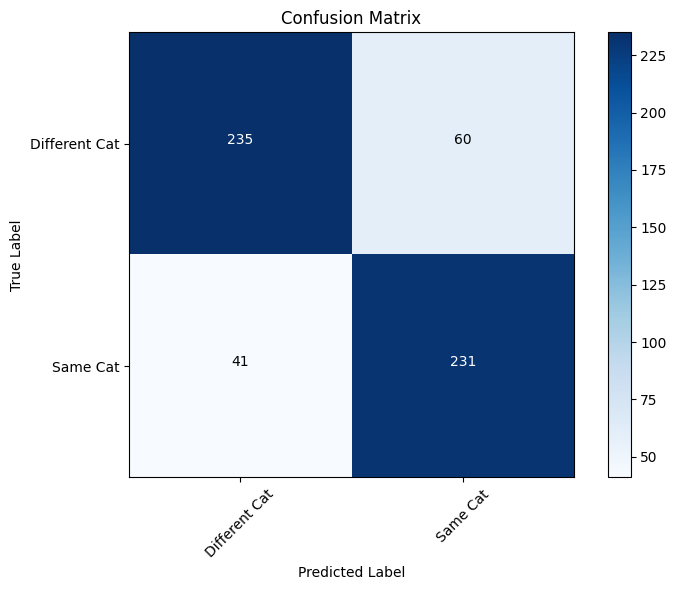

In [47]:

from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix

# Compute accuracy
accuracy = accuracy_score(labels, predictions)
print(f'Accuracy: {accuracy:.4f}')

# Compute precision
precision = precision_score(labels, predictions, average='macro')
print(f'Precision: {precision:.4f}')

# Compute recall
recall = recall_score(labels, predictions, average='macro')
print(f'Recall: {recall:.4f}')

# Compute confusion matrix
cm = confusion_matrix(labels, predictions)

# # Define class labels
class_labels = ['Different Cat', 'Same Cat']

# Plot confusion matrix
plt.figure(figsize=(8, 6))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

tick_marks = np.arange(len(class_labels))
plt.xticks(tick_marks, class_labels, rotation=45)
plt.yticks(tick_marks, class_labels)

fmt = 'd'
thresh = cm.max() / 2.
for i, j in np.ndindex(cm.shape):
    plt.text(j, i, format(cm[i, j], fmt),
             horizontalalignment="center",
             color="white" if cm[i, j] > thresh else "black")

plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.tight_layout()
plt.show()

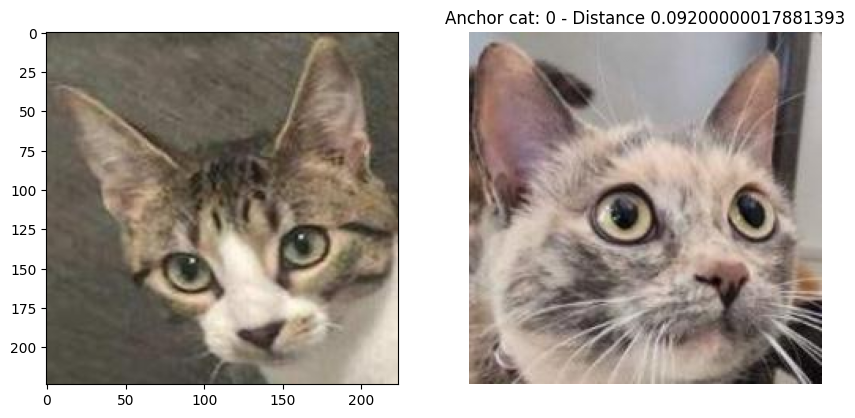

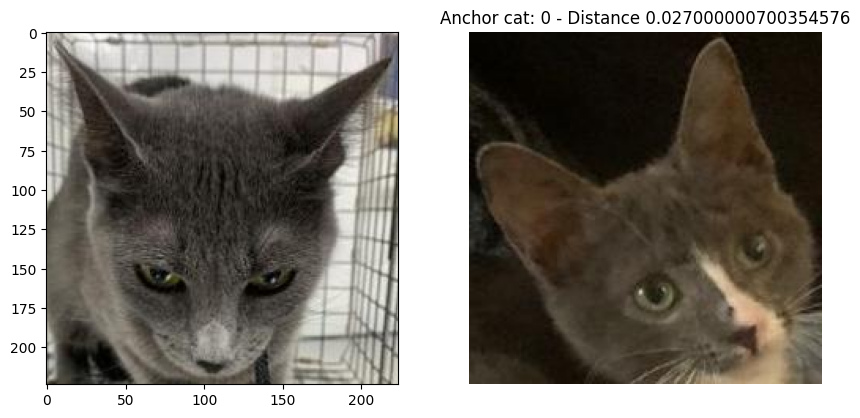

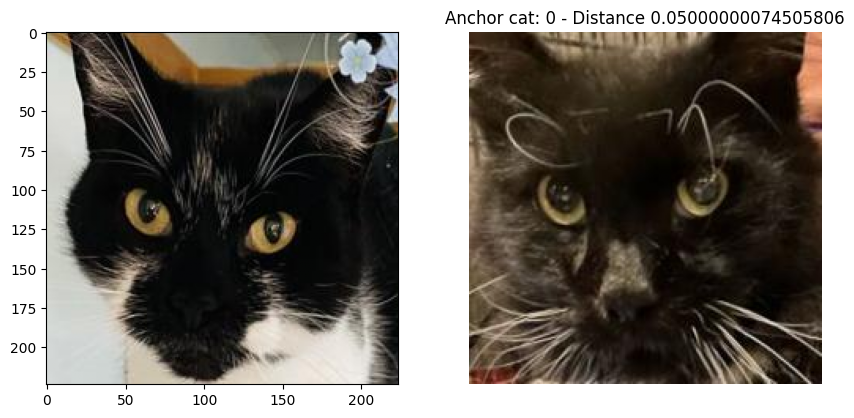

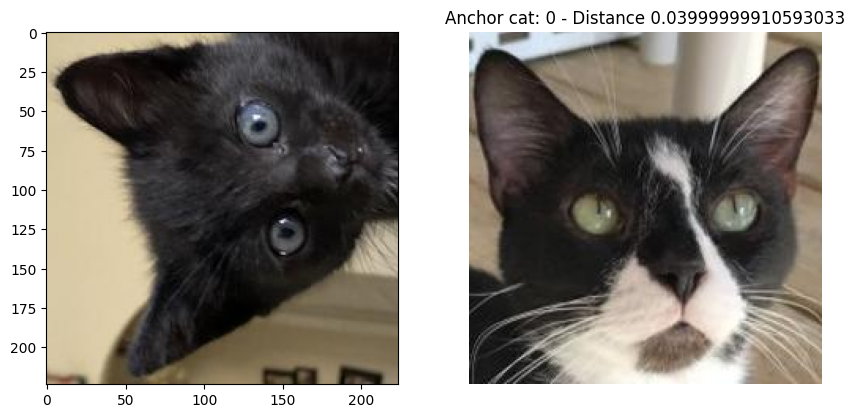

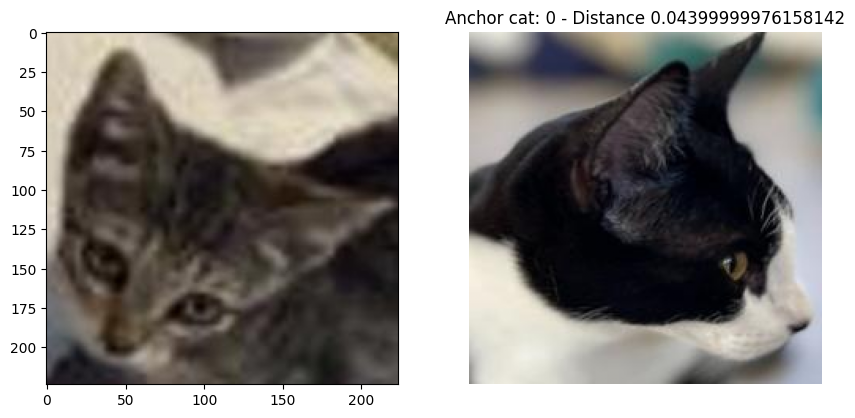

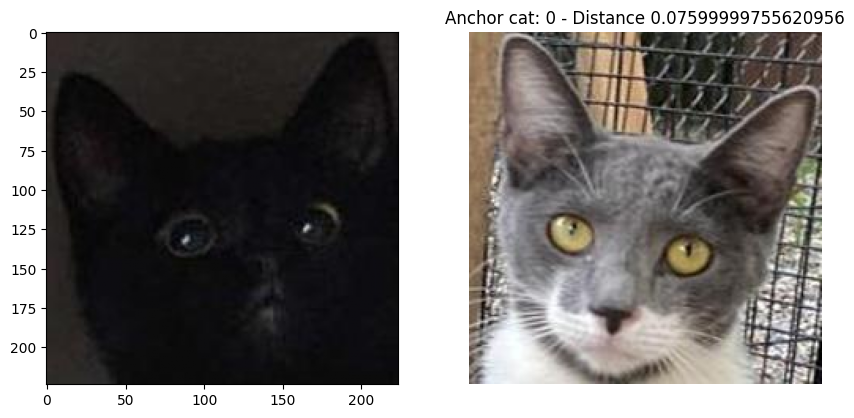

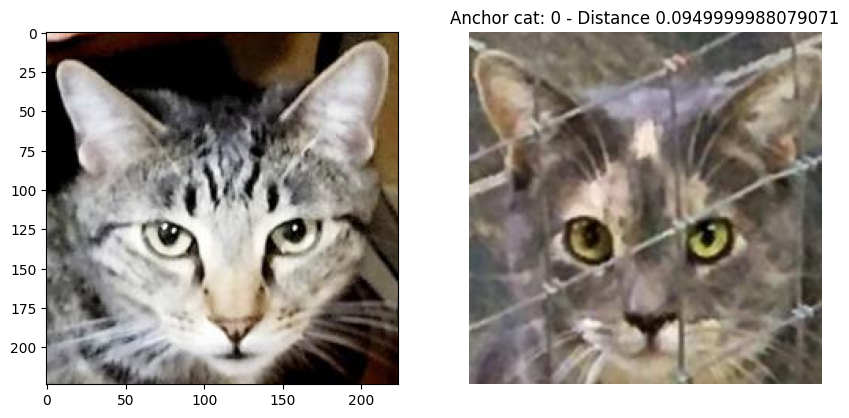

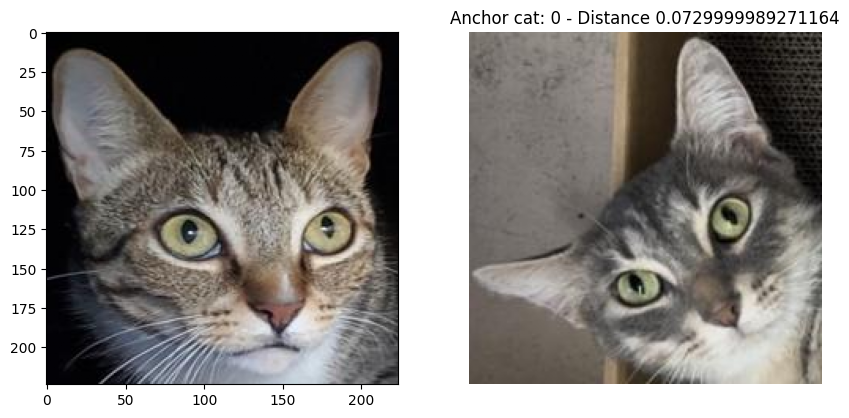

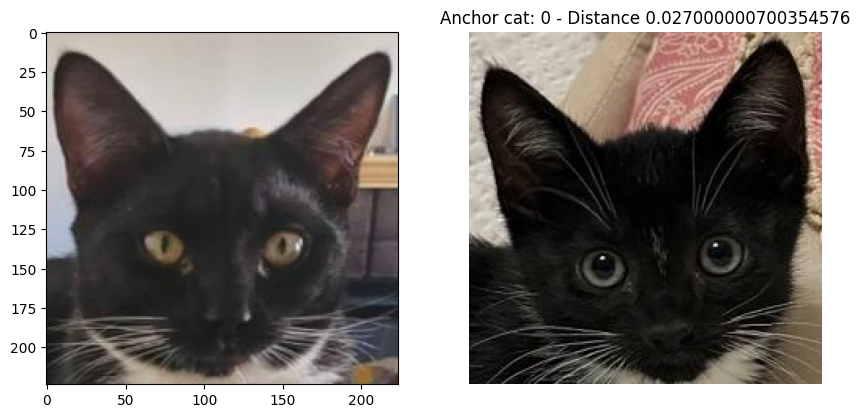

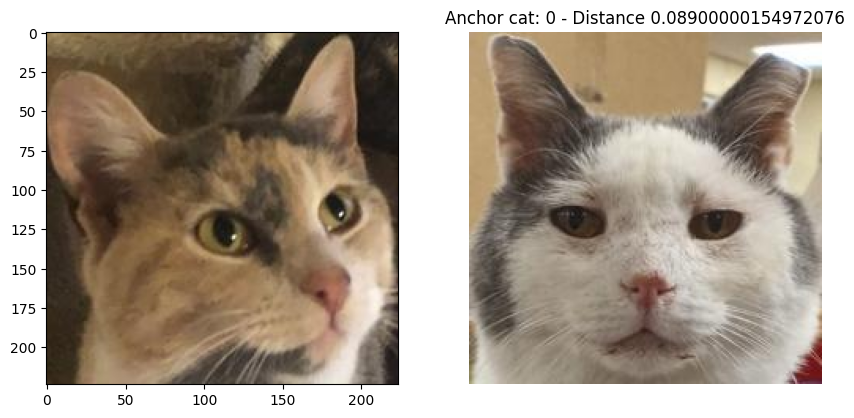

In [49]:
# printing 10 false positives
max = 10
count = 0
for i, (anchor,image, label, prediction)  in enumerate(zip(anchor_photos, compare_photos, labels, predictions)):
  if prediction == 1 and label == 0:
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(anchor)
    plt.subplot(1,2,2)
    plt.imshow(image)
    plt.title(f"Anchor cat: {labels[i]} - Distance {round(distances[i],3)}")
    plt.axis("off")
    count = count +1

    if count == max:
      break

In [50]:
# Como hay muchas imagenes en el dataset de testeo, solo lo voy a hacer con 250 gatos
unique_ids = val_df["id"].unique()
sampled_ids = np.random.choice(unique_ids, size=250, replace=False)
test_df = val_df[val_df["id"].isin(sampled_ids)]

In [66]:
test_df = val_df
labels = test_df["id"]

In [67]:
print(test_df.shape)
print(test_df["id"].unique().shape)

(1914, 2)
(567,)


In [68]:
# Codigo para obtener los embeddings de todas las imagenes de testeo
i = 0
images_numpy = []
embeddings = []

while i < test_df.shape[0]:
  if i >= test_df.shape[0] - 2:
    break
  cat1 = test_df.iloc[i]
  cat2 = test_df.iloc[i+1]
  cat3 = test_df.iloc[i+2]

  image1 = process_cat(cat1["image"])
  image2 = process_cat(cat2["image"])
  image3 = process_cat(cat3["image"])

  images_numpy.append(image1)
  images_numpy.append(image2)
  images_numpy.append(image3)

  image1 = image1.reshape(1,224,224,3)
  image2 = image2.reshape(1,224,224,3)
  image3 = image3.reshape(1,224,224,3)

  image1 = tf.convert_to_tensor(image1, dtype=tf.float32)
  image2 = tf.convert_to_tensor(image2, dtype=tf.float32)
  image3 = tf.convert_to_tensor(image3, dtype=tf.float32)

  embedding1, embedding2, embedding3 = siameseModel.get_embeddings((image1 , image2, image3))
  embedding1 = embedding1.numpy()
  embedding2 = embedding2.numpy()
  embedding3 = embedding3.numpy()

  embeddings.append(embedding1)
  embeddings.append(embedding2)
  embeddings.append(embedding3)

  i = i + 3


# y ahora los que faltaron
while i < test_df.shape[0]:
  cat = test_df.iloc[i]
  image = process_cat(cat["image"])
  images_numpy.append(image)
  image = image.reshape(1,224,224,3)
  image = tf.convert_to_tensor(image, dtype=tf.float32)
  embedding, _ ,_  = siameseModel.get_embeddings((image, image, image))
  embedding = embedding.numpy()
  embeddings.append(embedding)
  i = i + 1

In [69]:
# Compute distances to each embedding
unique_cats = test_df["id"].unique()
anchor_cats = []
rank = 10 # how many best distances
results = []

for cat in unique_cats:
  indexes = [i for i, name in enumerate(labels) if name == cat]
  #idx = random.choice(indexes)
  idx = indexes[0] # para que siempre sea el mismo
  anchor_cats.append(idx)
  print(cat, idx)
  cat_embedding = embeddings[idx]
  distances = []

  for index_emb, embedding in enumerate(embeddings):

    if index_emb != idx: # no con la misma foto del gato
      d = np.sum(np.square(cat_embedding - embedding))
    else:
      d = -1 # Assign -1 for the same photo

    distances.append(d)

  distances = np.array(distances)
  sorted_indices = np.argsort(distances)
  sorted_distances = distances[sorted_indices]

  # omitiendo el primero porque es la misma imagen
  sorted_indices = sorted_indices[1:rank]
  sorted_distances = sorted_distances[1:rank]

  prediction_vector = [int(item in indexes) for item in  sorted_indices]

  results.append((idx, cat, sorted_indices, sorted_distances, prediction_vector))


8-Yuki 0
11-Oreo 3
13-Chimuelo 6
18-Michu 9
19-Atenea 11
23-Sancho 13
20-Berta 15
26-tito 18
27-copito 20
Betty_54475280 23
Benny_71354595 26
Bekki_71458705 30
Bart_71354596 33
Banana_71261343 37
Baby SavITF_70922787 40
Ashley_53756664 44
Allie Kay_54476286 49
45211288_54476236 52
45211248_54476311 54
Ruby_58064128 56
Rosemary  ITF_69739061 61
Ringo_54476266 65
Pumpkin_54475228 67
Precious_54475200 69
Piston0010_71367268 71
Pirate_71514289 74
Peter _57582090 79
PealITF_71028623 83
Paulina_50817143 85
Patches_54475130 88
Panthera_71630617 90
Paco_54476313 92
Obsidian_54476305 95
Noir_54475330 97
Nellie_54476222 100
Mozart_69446604 103
Moth_71641111 108
Moss_70158258 111
MONICA_55509827 117
Mimi_69446608 123
Max_54476256 125
Maverick_70567636 128
Mary_70566886 131
Lunchbox_70927874 133
Luna_54476254 136
Luna_54475239 139
Lucy_59878011 141
Loverboy_70661299 146
Lou_71043419 151
Lizbeth_54475129 154
Kyo_69446552 156
Kibou_59878010 162
Joel_54476322 166
Jean Grey_59782224 168
Jane_69808293 

In [70]:
# check out rank10 results
rank10_predictions = [t[-1] for t in results]
correct_predictions = 0

# Check each vector in rank10_predictions
for vector in rank10_predictions:
    if any(elem == 1 for elem in vector):
        correct_predictions += 1

print(f"Number of correct predictions: {correct_predictions}")
print(f"Rank10 accuracy: {round(correct_predictions / len(results) * 100, 3)}")

Number of correct predictions: 143
Rank10 accuracy: 25.22


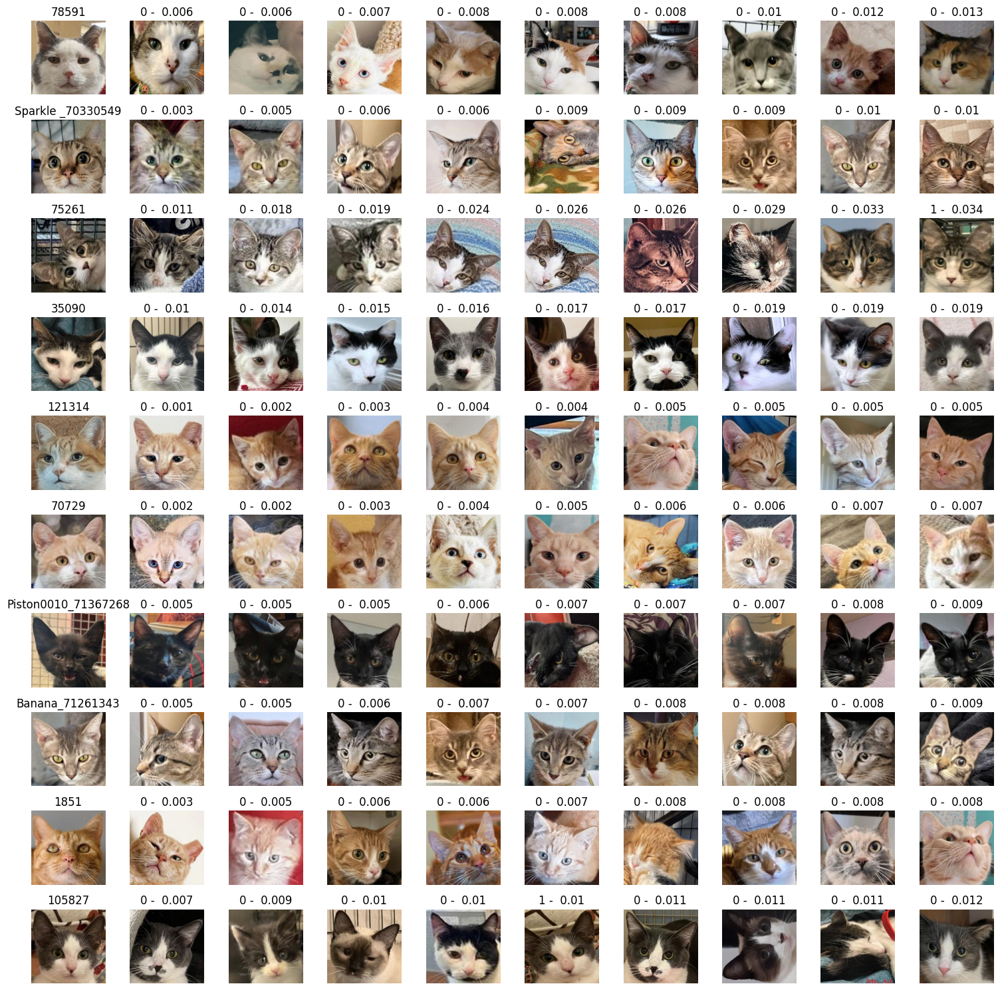

In [73]:
import random
import matplotlib.pyplot as plt
# printing results
def display_image(image, label, ax):
    ax.imshow(image)
    ax.set_title(label)
    ax.axis('off')

num_results = 10
results_sample = random.sample(results, num_results)

fig, axs = plt.subplots(num_results, 10, figsize=(15, 15))
for i, (idx, cat, sorted_indices, sorted_distances, prediction_vector) in enumerate(results_sample):
  cat_image = test_df.iloc[idx]
  cat_image = process_cat(cat_image["image"])
  display_image(cat_image, f"{cat}", axs[i, 0])

  for j, (cat_match, distance, prediction) in enumerate(zip(sorted_indices, sorted_distances, prediction_vector)):
    match_image = test_df.iloc[cat_match]
    match_image = process_cat(match_image["image"])
    display_image(match_image, f"{prediction} -  {round(distance,3)}", axs[i, j + 1])

plt.tight_layout()
plt.show()